# Library Imports

In [ ]:
import os
import math
import pandas as pd
import numpy as np
from datetime import datetime
np.set_printoptions(precision=2)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)
from functools import cmp_to_key

# %matplotlib notebook
%matplotlib inline
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from matplotlib.widgets import Slider
from IPython.core.display import display, HTML
import seaborn as sn

# import tensorflow.contrib.learn as skflow
# import tensorflow as tf
# tf.logging.set_verbosity(tf.logging.ERROR)
# from tensorflow.python.data import Dataset


from scipy.stats import boxcox
from scipy.special import inv_boxcox

from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures

from sklearn import linear_model
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet


from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import train_test_split

from sklearn import metrics
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

import tensorflow as tf
print('Using Tensorflow %s' % tf.__version__)

Using Tensorflow 2.2.0-rc3


# Helper Functions

In [ ]:
# Functions for preprocessing training data
def clip(series, clip_to_min, clip_to_max):
    # TODO: Use this to clip negative fire sizes from regression model
    """
    Clips each value in the series to the given min and max values
    e.g. ([-2, 4, 1], 0, 3) -> [0, 3, 1]
    """
    return series.apply(lambda x:(
        min(max(x, clip_to_min), clip_to_max)))

def z_score_transform(series):
    """Maps each element in a series to its z-score"""
    mean = series.mean()
    std_dv = series.std()
    res = {
        "series": series.apply(lambda x:(x - mean) / std_dv),
        "params": {
            "mean": mean,
            "std_dv": std_dv
        }
    }
    return res

def inv_z_score_transform(series, mean, std_dv):
    """Maps each z-score element in a series to its original value"""
    return series.apply(lambda x: x*std_dv+mean)
    
def root_transform(series):
    """Maps each element in a series to its square root"""
    min_val = series.min()
    res = {
        "series": series.apply(lambda x: math.sqrt(1.0+x-min_val)),
        "params": {
            "min_val": min_val
        }
    }
    return res

def inv_root_transform(series, min_val):
    """Maps each element in a series to its square"""
    return series.apply(lambda x: math.pow(x, 2)-1.0+min_val),

def box_cox_transform(series):
    """Applies a Box-Cox transformation to a series"""
    # make all values positive (Box-Cox requirement)
    min_val = series.min()
    box_cox_series, lmbda = boxcox(series.apply(lambda x: 1.0+x-min_val))
    res = {
        "series": box_cox_series,
        "params": {
            "min_val": min_val,
            "lmbda": lmbda
        }
    }
    return res
    
def inv_box_cox_transform(series, min_val, lmbda):
    """Applies an inverse Box-Cox transformation to a series with a given lambda value"""
    inv = inv_boxcox(series, lmbda)
    s = np.array([x-1.0+min_val for x in inv]).reshape(-1, 1)
    return s
    
def linear_transform(series):
    """Applies min-max scaling to each value in the series"""
    min_val = series.min()
    max_val = series.max()
    scale = (max_val - min_val) / 2.0
    res = {
        "series": series.apply(lambda x: (x - min_val) / scale - 1.0),
        "params": {
            "min_val": min_val,
            "scale": scale
        }
    }
    return res

def inv_linear_transform(series, min_val, scale):
    """Undoes min-max scaling to each value in the series"""
    return series.apply(lambda x: 1.0+(x*scale+min_val))

def log_transform(series):
    """Shifts each value in the series such that the min=1 then log transforms"""
    min_val = series.min()
    res = {
        "series": series.apply(lambda x: math.log(1.0+x-min_val)),
        "params": {
            "min_val": min_val
        }
    }
    return res

def log(series):
    """Log transforms a series with no negative values"""
    res = {
        "series": series.apply(lambda x: math.log(x))
    }
    return res

def inv_log(series):
    """Exponentiates log transformed values"""
    return series.apply(lambda x: math.exp(x))  

def inv_log_transform(series, min_val):
    """Exponentiates log transformed values then shifts each value back"""
    return series.apply(lambda x: math.exp(x)-1.0+min_val)

In [ ]:
# Functions for transforming and standardizing training data
def transform(dataframe, target):
    """Return the input dataframe with all its features normalized."""
    transformed = pd.DataFrame()
    params = {}
    def update_params(column, res):
      transformed[column] = res["series"]
      if res["params"]:
        params[column] = res["params"]

    features = [col for col in dataframe.columns.to_list() if col != target]

    # box-cox transform descriptive features
    for column in features:
      update_params(column, box_cox_transform(dataframe[column]))

    # z-score standardize descriptive features
    scaler = StandardScaler()
    transformed = pd.DataFrame(scaler.fit_transform(transformed), 
                               columns=features)
    
    # transform target
    update_params(target, box_cox_transform(dataframe[target]))

    return transformed, params, scaler

def unnormalize(dataframe, target, params, scaler):
    """
    Rescale and denormalize a z-score scaled and box-cox transformed dataframe 
    using shift and lambda parameters in params.
    """

    # undo descriptive feature z-score standardization
    features = [col for col in dataframe.columns.to_list() if col != target]
    untransformed = pd.DataFrame(scaler.inverse_transform(dataframe[features]),
                             columns=features)
    # undo descriptive feature box-cox transformation
    for col in features:
      untransformed[col] = inv_box_cox_transform(untransformed[col], **params[col])

    # undo target transformation
    untransformed[target] = inv_box_cox_transform(dataframe[target], 
                                              **params[target])
    return untransformed

In [ ]:
# Helper functions for working with our data schema
def ignition_index(indexed_feature):
    """Extracts the hour relative to fire ignition from an indexed feature.
    e.g.
    "temperature_24" -> 24
    "temperature_24^2" -> 24
    """
    return int(indexed_feature
               .replace("summary", "")
               .replace("precipType", "")
               .replace("temperature", "")
               .replace("apparentTemperature", "")
               .replace("dewPoint", "")
               .replace("humidity", "")
               .replace("pressure", "")
               .replace("windSpeed", "")
               .replace("windGust", "")
               .replace("windBearing", "")
               .replace("cloudCover", "")
               .replace("uvIndex", "")
               .replace("visibility", "")
               .replace("precipIntensity", "")
               .replace("precipProbability", "")
               .replace("_", "")
               .split("^")[0] # for polynomial features
              )

def indexed_feature_to_feature(indexed_feature):
    """
    Extracts the feature property names from an indexed feature name, including polynomial terms.
    e.g. "temperature_24" -> "temperature"
    "windSpeed48 pressure24" -> "pressure windSpeed" (sorts)
    """
    try:
        return " ".join([f.replace(str(ignition_index(f)), "") 
                         for f in sorted(indexed_feature.replace("_", "").split(" "))])
    except ValueError:
        return indexed_feature

def test_indexed_feature_to_feature():
    assert indexed_feature_to_feature("windSpeed0") == "windSpeed"
    assert indexed_feature_to_feature("windSpeed_24") == "windSpeed"
    assert indexed_feature_to_feature("windSpeed_24^2") == "windSpeed^2"
    assert indexed_feature_to_feature("windSpeed_24 temperature0") == "temperature windSpeed"
    assert indexed_feature_to_feature("temperature0 windSpeed_24") == "temperature windSpeed"
    
def has_numbers(string):
    """Determines if a string has an integers"""
    return any(char.isdigit() for char in string)

In [ ]:
def preprocess_master(dataframe, features):
    """
    Prepares input features from California wildfire data.
    dataframe: A Pandas DataFrame expected to contain data
      from the training.training wildfire collection.
    Returns: A Pandas DataFrame containing the features to be used for the model.
    """
    # keep all columns that look like a desired feature and restrict only daily data
    c1 = lambda col: not has_numbers(col) # keep non time indexed features
    c2 = lambda col: (has_numbers(col) and ignition_index(col) % 24 == 0) # keep daily features
    c3 = lambda col: any(map(lambda f: f in col, features)) # if any feature is a substring of the column
    # e.g. "temperature" -> "temperature_24", "temperature0", "temperature24", ...
    cols = [col for col in dataframe.columns if not ((c1(col) or c2(col)) and c3(col))]
    dataframe = dataframe.drop(columns=cols)
    # remove all rows containing a NaN in any remaining feature
    dataframe = dataframe.dropna().reset_index(drop=True)
    return dataframe

def test_preprocess_master():
    dataframe = pd.DataFrame(columns=["Event", "Latitude", "Longitude", "summary0", "precipType_24", "temperature24",
                         "apparentTemperature_48", "dewPoint0", "humidity_24", "pressure48", "windSpeed48", "windGust48",
                         "windBearing0", "cloudCover_366", "uvIndex366", "visibility96", "Size", "Costs"])
    features = ["temperature", "dewPoint", "humidity", "pressure",
            "windSpeed", "windGust", "windBearing", "Size"]
    df = preprocess_master(dataframe, features)
    assert np.array_equal(df.columns, ["temperature24","dewPoint0","humidity_24","pressure48","windSpeed48","windGust48","windBearing0","Size"])
    return df

def get_split(dataframe, features):
    """
    Creates a training, validation, and test data set from the given
    Pandas DataFrame and array of feature names.
    """
    df = dataframe.copy()
    
    # use only first n-1 features as model inputs
    descriptive_features = features[:-1]
    
    # want to predict nth feature
    target_features = features[-1]

    all_targets = df[target_features]

    # create index ranges for a 49/21/30 train/cross-validation/test split
    split_percent = .70
    training_size = math.floor(len(df.index) * split_percent * split_percent) # 70% of 70% ~ 50%
    validation_size = math.floor(len(df.index) * split_percent * (1 - split_percent)) # 30% of 70% ~ 20%
    
    # construct training, validation, and test datasets
    training_df = df[:training_size]
    validation_df = df[training_size:training_size+validation_size]
    test_df = df[training_size+validation_size:]
    
    def column_split(training_df):
        features = training_df.drop(columns=target_features)
        targets = training_df[target_features]
        return features, targets
    
    
    training_features, training_targets = column_split(training_df)
    validation_features, validation_targets = column_split(validation_df)
    test_features, test_targets = column_split(test_df)
    
    return training_features,\
            training_targets,\
            validation_features,\
            validation_targets,\
            test_features,\
            test_targets, \
            all_targets

In [ ]:
def feature_to_columns(df, feature):
    '''
    Returns the name of all columns in the dataframe containing the feature string.
    e.g. "temperature" -> ..., "temperature_24", "temperature0", "temperature24", ...
    '''
    return [x for x in df.columns.to_list() if feature in x]

def get_feature_bounds(df, feature):
    '''
    Returns the min and max value of a feature variable in the given dataframe.
    '''
    cols = feature_to_columns(df, feature)
    mn = min(df[cols].describe().loc["min"].to_list())
    mx = max(df[cols].describe().loc["max"].to_list())
    return mn, mx

# Load the Data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [ ]:
# load master data
# csv_path = "data/wildfire_events_full.csv"
csv_path = "drive/My Drive/Colab Notebooks/data/wildfire_events_full.csv"
df = pd.read_csv(csv_path, low_memory=False)

# shuffle the data to prevent bias
df = df.reindex(np.random.permutation(df.index)).reset_index(drop=True)
df.head(5)

,_id,Event,Latitude,Longitude,summary_336,precipType_336,temperature_336,apparentTemperature_336,dewPoint_336,humidity_336,pressure_336,windSpeed_336,windGust_336,windBearing_336,cloudCover_336,uvIndex_336,visibility_336,summary_335,precipType_335,temperature_335,apparentTemperature_335,dewPoint_335,humidity_335,pressure_335,windSpeed_335,windGust_335,windBearing_335,cloudCover_335,uvIndex_335,visibility_335,summary_334,precipType_334,temperature_334,apparentTemperature_334,dewPoint_334,humidity_334,pressure_334,windSpeed_334,windGust_334,windBearing_334,cloudCover_334,uvIndex_334,visibility_334,summary_333,precipType_333,temperature_333,apparentTemperature_333,dewPoint_333,humidity_333,pressure_333,windSpeed_333,windGust_333,windBearing_333,cloudCover_333,uvIndex_333,visibility_333,summary_332,precipType_332,temperature_332,apparentTemperature_332,dewPoint_332,humidity_332,pressure_332,windSpeed_332,windGust_332,windBearing_332,cloudCover_332,uvIndex_332,visibility_332,summary_331,precipType_331,temperature_331,apparentTemperature_331,dewPoint_331,humidity_331,pressure_331,windSpeed_331,windGust_331,windBearing_331,cloudCover_331,uvIndex_331,visibility_331,summary_330,precipType_330,temperature_330,apparentTemperature_330,dewPoint_330,humidity_330,pressure_330,windSpeed_330,windGust_330,windBearing_330,cloudCover_330,uvIndex_330,visibility_330,summary_329,precipType_329,temperature_329,apparentTemperature_329,dewPoint_329,humidity_329,pressure_329,windSpeed_329,windGust_329,windBearing_329,cloudCover_329,uvIndex_329,visibility_329,summary_328,precipType_328,temperature_328,apparentTemperature_328,dewPoint_328,humidity_328,pressure_328,windSpeed_328,windGust_328,windBearing_328,cloudCover_328,uvIndex_328,visibility_328,summary_327,precipType_327,temperature_327,apparentTemperature_327,dewPoint_327,humidity_327,pressure_327,windSpeed_327,windGust_327,windBearing_327,cloudCover_327,uvIndex_327,visibility_327,summary_326,precipType_326,temperature_326,apparentTemperature_326,dewPoint_326,humidity_326,pressure_326,windSpeed_326,windGust_326,windBearing_326,cloudCover_326,uvIndex_326,visibility_326,summary_325,precipType_325,temperature_325,apparentTemperature_325,dewPoint_325,humidity_325,pressure_325,windSpeed_325,windGust_325,windBearing_325,cloudCover_325,uvIndex_325,visibility_325,summary_324,precipType_324,temperature_324,apparentTemperature_324,dewPoint_324,humidity_324,pressure_324,windSpeed_324,windGust_324,windBearing_324,cloudCover_324,uvIndex_324,visibility_324,summary_323,precipType_323,temperature_323,apparentTemperature_323,dewPoint_323,humidity_323,pressure_323,windSpeed_323,windGust_323,windBearing_323,cloudCover_323,uvIndex_323,visibility_323,summary_322,precipType_322,temperature_322,apparentTemperature_322,dewPoint_322,humidity_322,pressure_322,windSpeed_322,windGust_322,windBearing_322,cloudCover_322,uvIndex_322,visibility_322,summary_321,precipType_321,temperature_321,apparentTemperature_321,dewPoint_321,humidity_321,pressure_321,windSpeed_321,windGust_321,windBearing_321,cloudCover_321,uvIndex_321,visibility_321,summary_320,precipType_320,temperature_320,apparentTemperature_320,dewPoint_320,humidity_320,pressure_320,windSpeed_320,windGust_320,windBearing_320,cloudCover_320,uvIndex_320,visibility_320,summary_319,precipType_319,temperature_319,apparentTemperature_319,dewPoint_319,humidity_319,pressure_319,windSpeed_319,windGust_319,windBearing_319,cloudCover_319,uvIndex_319,visibility_319,summary_318,precipType_318,temperature_318,apparentTemperature_318,dewPoint_318,humidity_318,pressure_318,windSpeed_318,windGust_318,windBearing_318,cloudCover_318,uvIndex_318,visibility_318,summary_317,precipType_317,temperature_317,apparentTemperature_317,dewPoint_317,humidity_317,pressure_317,windSpeed_317,windGust_317,windBearing_317,cloudCover_317,uvIndex_317,visibility_317,summary_316,precipType_316,temperature_316,apparentTemperature_316,dewPoint_316,humidity_316,pressure_316,windSpeed_316,windGust_316,windBearing_316,c

In [ ]:
# Select the features to begin modeling, leaving the last feature as the target

# Features available
# Event, Latitude, Longitude, summary, precipType, temperature, apparentTemperature,
# dewPoint, humidity, pressure, windSpeed, windGust, windBearing, cloudCover,
# uvIndex, visibility, Size, Costs

# After testing I found these features to have these distributions:
# temperature: normal
# pressure: normal
# dewPoint: transform normal
# humidity: transform normal
# windSpeed: transform normal
# windGust: transform normal
# Size: transform normal
# windBearing: not transform normal
# cloudCover: not transform normal
# visibility: not transform normal
# precipIntensity: 
# precipProbability: 
# Note: cloudCover, visibility both skewed heavily due to clipping in measurement => likely not random so don't use!

# features = ["temperature", "dewPoint", "humidity", "pressure",
#             "windSpeed", "windGust", "Size"]

features = ["temperature", "humidity", "pressure",
            "windSpeed", "Size"]

all_df = preprocess_master(df, features)
all_df.head(5)

,temperature_336,humidity_336,pressure_336,windSpeed_336,temperature_312,humidity_312,pressure_312,windSpeed_312,temperature_288,humidity_288,pressure_288,windSpeed_288,temperature_264,humidity_264,pressure_264,windSpeed_264,temperature_240,humidity_240,pressure_240,windSpeed_240,temperature_216,humidity_216,pressure_216,windSpeed_216,temperature_192,humidity_192,pressure_192,windSpeed_192,temperature_168,humidity_168,pressure_168,windSpeed_168,temperature_144,humidity_144,pressure_144,windSpeed_144,temperature_120,humidity_120,pressure_120,windSpeed_120,temperature_96,humidity_96,pressure_96,windSpeed_96,temperature_72,humidity_72,pressure_72,windSpeed_72,temperature_48,humidity_48,pressure_48,windSpeed_48,temperature_24,humidity_24,pressure_24,windSpeed_24,temperature0,humidity0,pressure0,windSpeed0,temperature24,humidity24,pressure24,windSpeed24,temperature48,humidity48,pressure48,windSpeed48,temperature72,humidity72,pressure72,windSpeed72,temperature96,humidity96,pressure96,windSpeed96,temperature120,humidity120,pressure120,windSpeed120,temperature144,humidity144,pressure144,windSpeed144,temperature168,humidity168,pressure168,windSpeed168,temperature192,humidity192,pressure192,windSpeed192,temperature216,humidity216,pressure216,windSpeed216,temperature240,humidity240,pressure240,windSpeed240,temperature264,humidity264,pressure264,windSpeed264,temperature288,humidity288,pressure288,windSpeed288,temperature312,humidity312,pressure312,windSpeed312,temperature336,humidity336,pressure336,windSpeed336,Size
0,60.70,0.26,1011.88,0.95,55.87,0.39,1013.39,0.85,53.71,0.44,1012.25,1.18,52.32,0.51,1013.54,1.10,52.89,0.41,1011.67,0.74,52.07,0.55,1013.18,0.42,53.54,0.56,1016.78,0.42,57.27,0.57,1019.69,0.34,59.85,0.49,1016.50,0.42,60.82,0.41,1014.20,0.70,62.49,0.34,1016.30,0.79,59.07,0.47,1017.05,0.72,60.74,0.45,1013.59,0.81,60.75,0.47,1014.62,1.15,60.61,0.43,1015.41,0.75,59.57,0.52,1016.31,1.08,60.75,0.51,1014.13,0.90,60.76,0.49,1014.17,0.56,55.55,0.64,1017.98,0.53,56.44,0.37,1020.24,0.52,55.48,0.26,1017.76,0.61,54.78,0.38,1014.92,0.60,54.42,0.45,1015.75,0.28,55.41,0.47,1017.81,0.28,57.35,0.35,1021.07,0.31,60.08,0.32,1018.64,0.86,62.85,0.30,1010.40,2.12,57.39,0.47,1014.45,0.95,56.41,0.43,1011.21,0.86,655.0
1,54.59,0.80,1021.41,0.73,53.39,0.84,1020.50,0.69,51.77,0.82,1020.09,0.29,53.05,0.81,1018.49,1.09,52.51,0.80,1019.81,0.86,62.54,0.63,1013.50,2.19,60.71,0.70,1013.41,1.24,58.73,0.78,1017.71,0.48,56.38,0.82,1018.19,0.38,55.92,0.84,1018.80,0.42,54.76,0.87,1015.99,0.88,58.82,0.67,1015.29,0.30,61.39,0.80,1015.29,1.33,58.37,0.80,1017.49,0.56,61.12,0.84,1015.99,0.58,62.29,0.72,1013.20,0.28,72.12,0.46,1011.50,2.23,73.53,0.48,1008.19,0.85,71.07,0.52,1010.40,0.89,68.14,0.45,1012.29,2.05,67.77,0.54,1013.71,0.55,62.07,0.72,1017.38,1.33,64.52,0.68,1014.99,0.96,61.43,0.76,1016.19,0.66,56.41,0.81,1019.81,1.15,63.61,0.54,1020.62,0.60,59.66,0.65,1019.22,1.21,62.42,0.58,1013.59,1.30,59.35,0.63,1012.40,1.63,10.0
2,53.75,0.52,1015.42,5.61,57.99,0.67,1016.50,1.45,54.25,0.87,1018.80,3.83,61.17,0.59,1020.01,6.23,64.90,0.45,1015.62,4.44,69.96,0.41,1015.62,4.21,72.36,0.42,1011.50,4.73,73.58,0.22,1011.79,6.63,70.32,0.38,1014.29,10.15,71.12,0.31,1014.39,7.19,73.35,0.32,1011.71,2.84,79.55,0.22,1012.91,4.16,79.88,0.25,1012.40,3.64,81.48,0.25,1010.90,4.30,77.30,0.33,1009.70,2.93,77.67,0.38,1007.00,3.65,77.30,0.39,1008.40,2.20,78.19,0.37,1011.21,4.30,76.87,0.45,1011.79,2.97,74.32,0.44,1011.50,5.00,72.14,0.43,1011.00,3.92,71.74,0.47,1011.29,2.09,72.25,0.49,1011.50,2.86,72.21,0.54,1012.29,5.78,64.22,0.51,1015.09,4.45,65.60,0.45,1014.90,4.22,69.74,0.35,1009.40,5.61,69.69,0.41,1012.60,3.27,74.95,0.38,1012.40,4.76,464.0
3,64.81,0.55,1013.71,3.17,59.35,0.63,1017.65,1.97,65.31,0.54,1018.90,11.51,65.37,0.44,1018.06,3.91,65.25,0.56,1014.65,2.79,61.09,0.53,1015.53,9.21,62.33,0.49,1015.99,10.35,65.99,0.50,1015.57,13.82,64.75,0.59,1015.78,5.08,61.71,0.57,1019.55,10.35,64.75,0.34,1022.49,3.56,64.81,0.47,1017.81,1.58,73.76,0.48,1016.08,2.27,79.71,0.39,1014.45,1.26,73.79,0.46,1014.

In [ ]:
all_df.describe()

,temperature_336,humidity_336,pressure_336,windSpeed_336,temperature_312,humidity_312,pressure_312,windSpeed_312,temperature_288,humidity_288,pressure_288,windSpeed_288,temperature_264,humidity_264,pressure_264,windSpeed_264,temperature_240,humidity_240,pressure_240,windSpeed_240,temperature_216,humidity_216,pressure_216,windSpeed_216,temperature_192,humidity_192,pressure_192,windSpeed_192,temperature_168,humidity_168,pressure_168,windSpeed_168,temperature_144,humidity_144,pressure_144,windSpeed_144,temperature_120,humidity_120,pressure_120,windSpeed_120,temperature_96,humidity_96,pressure_96,windSpeed_96,temperature_72,humidity_72,pressure_72,windSpeed_72,temperature_48,humidity_48,pressure_48,windSpeed_48,temperature_24,humidity_24,pressure_24,windSpeed_24,temperature0,humidity0,pressure0,windSpeed0,temperature24,humidity24,pressure24,windSpeed24,temperature48,humidity48,pressure48,windSpeed48,temperature72,humidity72,pressure72,windSpeed72,temperature96,humidity96,pressure96,windSpeed96,temperature120,humidity120,pressure120,windSpeed120,temperature144,humidity144,pressure144,windSpeed144,temperature168,humidity168,pressure168,windSpeed168,temperature192,humidity192,pressure192,windSpeed192,temperature216,humidity216,pressure216,windSpeed216,temperature240,humidity240,pressure240,windSpeed240,temperature264,humidity264,pressure264,windSpeed264,temperature288,humidity288,pressure288,windSpeed288,temperature312,humidity312,pressure312,windSpeed312,temperature336,humidity336,pressure336,windSpeed336,Size
count,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000,1133.000000
mean,60.488049,0.618720,1013.223389,1.868323,60.495825,0.614484,1013.249091,1.743672,60.673610,0.614872,1013.207652,1.720388,60.569912,0.620556,1013.174360,1.707661,60.657193,0.615437,1013.174431,1.668129,60.862701,0.612312,1013.286673,1.748367,61.226214,0.607944,1013.183654,1.786028,61.270141,0.609806,1013.095878,1.743575,61.324987,0.609876,1013.050918,1.749453,61.414192,0.603733,1013.107405,1.696752,61.573354,0.598314,1013.211721,1.743892,61.612074,0.591986,1013.225057,1.715172,62.005243,0.573672,1013.221677,1.723363,62.509347,0.551951,1013.210574,1.700432,63.260803,0.523901,1013.034069,1.989047,63.374590,0.518756,1013.061077,2.086019,62.679259,0.549435,1013.056452,1.712621,62.112524,0.574060,1012.953716,1.693124,61.780371,0.590203,1013.090733,1.696884,61.485013,0.600291,1013.103954,1.698332,61.472154,0.602436,1013.071483,1.677458,61.553063,0.603989,1013.159718,1.627546,61.739788,0.604625,1013.321536,1.716505,61.710221,0.602745,1013.284395,1.665349,61.657970,0.605781,1013.199082,1.631492,61.694810,0.610177,1013.119673,1.642171,61.478261,0.614

# Exploratory Data Analysis

In [ ]:
# Check the distribution of all descriptive features
# based on fire size quartile
display(HTML("<style>.container { width:100% !important; }</style>"))

f = "Size"
describe_df = all_df[f].describe()
Q1 = describe_df["25%"]
Q2 = describe_df["50%"]
Q3 = describe_df["75%"]
MAX = describe_df["max"]
MIN = describe_df["min"]
IQR = Q3-Q1

# construct fire size range with no "outliers" via Tukey's method
lower_threshold_tukey = Q1-1.5*IQR
upper_threshold_tukey = Q3+1.5*IQR

# construct fire size range with no "outliers"
lower_threshold = MIN
upper_threshold = upper_threshold_tukey

# construct the dataframe of outlier-reduced fire sizes
qdf = all_df[(lower_threshold <= all_df[f]) & (all_df[f] <= upper_threshold)]
qdf.describe()[["Size"]]

,Size
count,955.000000
mean,326.544754
std,451.696450
min,0.100000
25%,35.000000
50%,120.000000
75%,418.000000
max,2270.000000


In [ ]:
qdf.head(5)

,temperature_336,humidity_336,pressure_336,windSpeed_336,temperature_312,humidity_312,pressure_312,windSpeed_312,temperature_288,humidity_288,pressure_288,windSpeed_288,temperature_264,humidity_264,pressure_264,windSpeed_264,temperature_240,humidity_240,pressure_240,windSpeed_240,temperature_216,humidity_216,pressure_216,windSpeed_216,temperature_192,humidity_192,pressure_192,windSpeed_192,temperature_168,humidity_168,pressure_168,windSpeed_168,temperature_144,humidity_144,pressure_144,windSpeed_144,temperature_120,humidity_120,pressure_120,windSpeed_120,temperature_96,humidity_96,pressure_96,windSpeed_96,temperature_72,humidity_72,pressure_72,windSpeed_72,temperature_48,humidity_48,pressure_48,windSpeed_48,temperature_24,humidity_24,pressure_24,windSpeed_24,temperature0,humidity0,pressure0,windSpeed0,temperature24,humidity24,pressure24,windSpeed24,temperature48,humidity48,pressure48,windSpeed48,temperature72,humidity72,pressure72,windSpeed72,temperature96,humidity96,pressure96,windSpeed96,temperature120,humidity120,pressure120,windSpeed120,temperature144,humidity144,pressure144,windSpeed144,temperature168,humidity168,pressure168,windSpeed168,temperature192,humidity192,pressure192,windSpeed192,temperature216,humidity216,pressure216,windSpeed216,temperature240,humidity240,pressure240,windSpeed240,temperature264,humidity264,pressure264,windSpeed264,temperature288,humidity288,pressure288,windSpeed288,temperature312,humidity312,pressure312,windSpeed312,temperature336,humidity336,pressure336,windSpeed336,Size
0,60.70,0.26,1011.88,0.95,55.87,0.39,1013.39,0.85,53.71,0.44,1012.25,1.18,52.32,0.51,1013.54,1.10,52.89,0.41,1011.67,0.74,52.07,0.55,1013.18,0.42,53.54,0.56,1016.78,0.42,57.27,0.57,1019.69,0.34,59.85,0.49,1016.50,0.42,60.82,0.41,1014.20,0.70,62.49,0.34,1016.30,0.79,59.07,0.47,1017.05,0.72,60.74,0.45,1013.59,0.81,60.75,0.47,1014.62,1.15,60.61,0.43,1015.41,0.75,59.57,0.52,1016.31,1.08,60.75,0.51,1014.13,0.90,60.76,0.49,1014.17,0.56,55.55,0.64,1017.98,0.53,56.44,0.37,1020.24,0.52,55.48,0.26,1017.76,0.61,54.78,0.38,1014.92,0.60,54.42,0.45,1015.75,0.28,55.41,0.47,1017.81,0.28,57.35,0.35,1021.07,0.31,60.08,0.32,1018.64,0.86,62.85,0.30,1010.40,2.12,57.39,0.47,1014.45,0.95,56.41,0.43,1011.21,0.86,655.0
1,54.59,0.80,1021.41,0.73,53.39,0.84,1020.50,0.69,51.77,0.82,1020.09,0.29,53.05,0.81,1018.49,1.09,52.51,0.80,1019.81,0.86,62.54,0.63,1013.50,2.19,60.71,0.70,1013.41,1.24,58.73,0.78,1017.71,0.48,56.38,0.82,1018.19,0.38,55.92,0.84,1018.80,0.42,54.76,0.87,1015.99,0.88,58.82,0.67,1015.29,0.30,61.39,0.80,1015.29,1.33,58.37,0.80,1017.49,0.56,61.12,0.84,1015.99,0.58,62.29,0.72,1013.20,0.28,72.12,0.46,1011.50,2.23,73.53,0.48,1008.19,0.85,71.07,0.52,1010.40,0.89,68.14,0.45,1012.29,2.05,67.77,0.54,1013.71,0.55,62.07,0.72,1017.38,1.33,64.52,0.68,1014.99,0.96,61.43,0.76,1016.19,0.66,56.41,0.81,1019.81,1.15,63.61,0.54,1020.62,0.60,59.66,0.65,1019.22,1.21,62.42,0.58,1013.59,1.30,59.35,0.63,1012.40,1.63,10.0
2,53.75,0.52,1015.42,5.61,57.99,0.67,1016.50,1.45,54.25,0.87,1018.80,3.83,61.17,0.59,1020.01,6.23,64.90,0.45,1015.62,4.44,69.96,0.41,1015.62,4.21,72.36,0.42,1011.50,4.73,73.58,0.22,1011.79,6.63,70.32,0.38,1014.29,10.15,71.12,0.31,1014.39,7.19,73.35,0.32,1011.71,2.84,79.55,0.22,1012.91,4.16,79.88,0.25,1012.40,3.64,81.48,0.25,1010.90,4.30,77.30,0.33,1009.70,2.93,77.67,0.38,1007.00,3.65,77.30,0.39,1008.40,2.20,78.19,0.37,1011.21,4.30,76.87,0.45,1011.79,2.97,74.32,0.44,1011.50,5.00,72.14,0.43,1011.00,3.92,71.74,0.47,1011.29,2.09,72.25,0.49,1011.50,2.86,72.21,0.54,1012.29,5.78,64.22,0.51,1015.09,4.45,65.60,0.45,1014.90,4.22,69.74,0.35,1009.40,5.61,69.69,0.41,1012.60,3.27,74.95,0.38,1012.40,4.76,464.0
4,61.49,0.79,1013.20,0.19,61.79,0.80,1015.19,0.05,62.22,0.81,1017.20,1.04,62.10,0.83,1017.31,0.35,60.98,0.86,1013.50,0.00,61.50,0.81,1010.96,0.02,62.08,0.82,1013.85,0.69,63.75,0.82,1016.10,0.04,63.85,0.79,1016.15,0.24,64.56,0.75,1013.88,0.44,62.87,0.72,1011.11,0.19,61.75,0.81,1013.36,1.72,60.61,0.77,1015.36,1.54,61.25,0.77,1015.46,1.62,59.27,0.80,1017.20,0

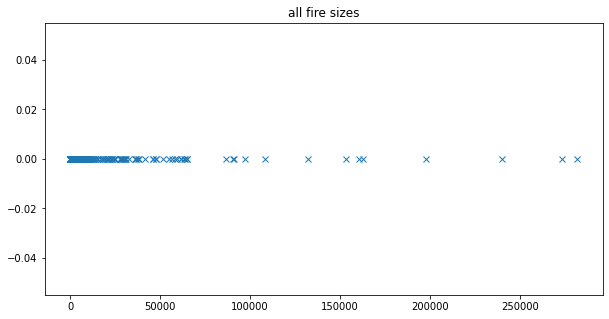

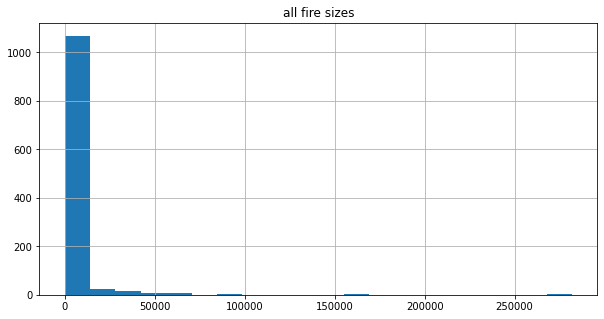

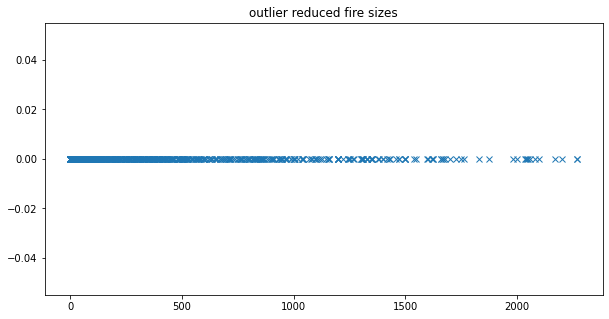

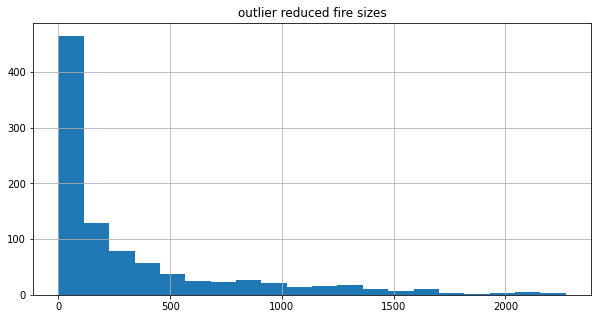

In [ ]:
# Visualize the distribution of fire size in a single dimension

# plot the distribution of all fire sizes
# plt.close("all")
all_sizes = all_df["Size"]

fig = plt.figure(figsize=(10, 5))
ax = fig.add_subplot(111)
ax.set_title("all fire sizes")
val = 0. # this is the value where you want the data to appear on the y-axis.
plt.plot(all_sizes, np.zeros_like(all_sizes) + val, 'x')


fig = plt.figure(figsize=(10, 5))
ax = fig.add_subplot(111)
ax.set_title("all fire sizes")
all_hist = all_df["Size"].hist(bins=20, xlabelsize=10)


# plot the distribution of the outlier reduced fire sizes
outlier_reduced_sizes = qdf["Size"]
fig = plt.figure(figsize=(10, 5))
ax = fig.add_subplot(111)
ax.set_title("outlier reduced fire sizes")
plt.plot(outlier_reduced_sizes, np.zeros_like(outlier_reduced_sizes) + val, 'x')


fig = plt.figure(figsize=(10, 5))
ax = fig.add_subplot(111)
ax.set_title("outlier reduced fire sizes")
out_red_hist = outlier_reduced_sizes.hist(bins=20, xlabelsize=10)

# Feature Selection

In [ ]:
# Find (and remove) all redundant features

correlated_features = set()
correlation_matrix = qdf.drop("Size", axis=1).corr() # remove target feature
correlation_threshold = 0.9 # two features' correlation coefficient should be <

# find all pair-wise correlated descriptive features via their Pearson correlation
for i in range(len(correlation_matrix.columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > correlation_threshold:
            colname = correlation_matrix.columns[i]
            correlated_features.add(colname)

# the outlier-reduced dataframe with non pair-wise correlated descriptive features
# cdf = qdf.drop(correlated_features, axis=1).reset_index(drop=True)
cdf = qdf.reset_index(drop=True)

print(str(len(correlated_features))+" features correlated from "+str(len(qdf.columns))+" total:")
print(sorted(list(correlated_features)))
print("\n")
print(str(len(cdf.columns))+" features remaining:")
print(sorted(cdf.columns.to_list()))

25 features correlated from 117 total:
['temperature120', 'temperature144', 'temperature168', 'temperature192', 'temperature216', 'temperature240', 'temperature264', 'temperature288', 'temperature312', 'temperature336', 'temperature48', 'temperature96', 'temperature_120', 'temperature_144', 'temperature_168', 'temperature_192', 'temperature_216', 'temperature_24', 'temperature_240', 'temperature_264', 'temperature_288', 'temperature_312', 'temperature_48', 'temperature_72', 'temperature_96']


117 features remaining:
['Size', 'humidity0', 'humidity120', 'humidity144', 'humidity168', 'humidity192', 'humidity216', 'humidity24', 'humidity240', 'humidity264', 'humidity288', 'humidity312', 'humidity336', 'humidity48', 'humidity72', 'humidity96', 'humidity_120', 'humidity_144', 'humidity_168', 'humidity_192', 'humidity_216', 'humidity_24', 'humidity_240', 'humidity_264', 'humidity_288', 'humidity_312', 'humidity_336', 'humidity_48', 'humidity_72', 'humidity_96', 'pressure0', 'pressure120', '

In [ ]:
print(len(cdf.columns))
cdf.head(5)

117


,temperature_336,humidity_336,pressure_336,windSpeed_336,temperature_312,humidity_312,pressure_312,windSpeed_312,temperature_288,humidity_288,pressure_288,windSpeed_288,temperature_264,humidity_264,pressure_264,windSpeed_264,temperature_240,humidity_240,pressure_240,windSpeed_240,temperature_216,humidity_216,pressure_216,windSpeed_216,temperature_192,humidity_192,pressure_192,windSpeed_192,temperature_168,humidity_168,pressure_168,windSpeed_168,temperature_144,humidity_144,pressure_144,windSpeed_144,temperature_120,humidity_120,pressure_120,windSpeed_120,temperature_96,humidity_96,pressure_96,windSpeed_96,temperature_72,humidity_72,pressure_72,windSpeed_72,temperature_48,humidity_48,pressure_48,windSpeed_48,temperature_24,humidity_24,pressure_24,windSpeed_24,temperature0,humidity0,pressure0,windSpeed0,temperature24,humidity24,pressure24,windSpeed24,temperature48,humidity48,pressure48,windSpeed48,temperature72,humidity72,pressure72,windSpeed72,temperature96,humidity96,pressure96,windSpeed96,temperature120,humidity120,pressure120,windSpeed120,temperature144,humidity144,pressure144,windSpeed144,temperature168,humidity168,pressure168,windSpeed168,temperature192,humidity192,pressure192,windSpeed192,temperature216,humidity216,pressure216,windSpeed216,temperature240,humidity240,pressure240,windSpeed240,temperature264,humidity264,pressure264,windSpeed264,temperature288,humidity288,pressure288,windSpeed288,temperature312,humidity312,pressure312,windSpeed312,temperature336,humidity336,pressure336,windSpeed336,Size
0,60.70,0.26,1011.88,0.95,55.87,0.39,1013.39,0.85,53.71,0.44,1012.25,1.18,52.32,0.51,1013.54,1.10,52.89,0.41,1011.67,0.74,52.07,0.55,1013.18,0.42,53.54,0.56,1016.78,0.42,57.27,0.57,1019.69,0.34,59.85,0.49,1016.50,0.42,60.82,0.41,1014.20,0.70,62.49,0.34,1016.30,0.79,59.07,0.47,1017.05,0.72,60.74,0.45,1013.59,0.81,60.75,0.47,1014.62,1.15,60.61,0.43,1015.41,0.75,59.57,0.52,1016.31,1.08,60.75,0.51,1014.13,0.90,60.76,0.49,1014.17,0.56,55.55,0.64,1017.98,0.53,56.44,0.37,1020.24,0.52,55.48,0.26,1017.76,0.61,54.78,0.38,1014.92,0.60,54.42,0.45,1015.75,0.28,55.41,0.47,1017.81,0.28,57.35,0.35,1021.07,0.31,60.08,0.32,1018.64,0.86,62.85,0.30,1010.40,2.12,57.39,0.47,1014.45,0.95,56.41,0.43,1011.21,0.86,655.0
1,54.59,0.80,1021.41,0.73,53.39,0.84,1020.50,0.69,51.77,0.82,1020.09,0.29,53.05,0.81,1018.49,1.09,52.51,0.80,1019.81,0.86,62.54,0.63,1013.50,2.19,60.71,0.70,1013.41,1.24,58.73,0.78,1017.71,0.48,56.38,0.82,1018.19,0.38,55.92,0.84,1018.80,0.42,54.76,0.87,1015.99,0.88,58.82,0.67,1015.29,0.30,61.39,0.80,1015.29,1.33,58.37,0.80,1017.49,0.56,61.12,0.84,1015.99,0.58,62.29,0.72,1013.20,0.28,72.12,0.46,1011.50,2.23,73.53,0.48,1008.19,0.85,71.07,0.52,1010.40,0.89,68.14,0.45,1012.29,2.05,67.77,0.54,1013.71,0.55,62.07,0.72,1017.38,1.33,64.52,0.68,1014.99,0.96,61.43,0.76,1016.19,0.66,56.41,0.81,1019.81,1.15,63.61,0.54,1020.62,0.60,59.66,0.65,1019.22,1.21,62.42,0.58,1013.59,1.30,59.35,0.63,1012.40,1.63,10.0
2,53.75,0.52,1015.42,5.61,57.99,0.67,1016.50,1.45,54.25,0.87,1018.80,3.83,61.17,0.59,1020.01,6.23,64.90,0.45,1015.62,4.44,69.96,0.41,1015.62,4.21,72.36,0.42,1011.50,4.73,73.58,0.22,1011.79,6.63,70.32,0.38,1014.29,10.15,71.12,0.31,1014.39,7.19,73.35,0.32,1011.71,2.84,79.55,0.22,1012.91,4.16,79.88,0.25,1012.40,3.64,81.48,0.25,1010.90,4.30,77.30,0.33,1009.70,2.93,77.67,0.38,1007.00,3.65,77.30,0.39,1008.40,2.20,78.19,0.37,1011.21,4.30,76.87,0.45,1011.79,2.97,74.32,0.44,1011.50,5.00,72.14,0.43,1011.00,3.92,71.74,0.47,1011.29,2.09,72.25,0.49,1011.50,2.86,72.21,0.54,1012.29,5.78,64.22,0.51,1015.09,4.45,65.60,0.45,1014.90,4.22,69.74,0.35,1009.40,5.61,69.69,0.41,1012.60,3.27,74.95,0.38,1012.40,4.76,464.0
3,61.49,0.79,1013.20,0.19,61.79,0.80,1015.19,0.05,62.22,0.81,1017.20,1.04,62.10,0.83,1017.31,0.35,60.98,0.86,1013.50,0.00,61.50,0.81,1010.96,0.02,62.08,0.82,1013.85,0.69,63.75,0.82,1016.10,0.04,63.85,0.79,1016.15,0.24,64.56,0.75,1013.88,0.44,62.87,0.72,1011.11,0.19,61.75,0.81,1013.36,1.72,60.61,0.77,1015.36,1.54,61.25,0.77,1015.46,1.62,59.27,0.80,1017.20,0

In [ ]:
# Find top descriptive features most correlated to target
# Note: Can perform "filter" feature selection by keeping only top n descriptive features, but not done currently

def top_target_correlated(dataframe, target):
    # create correlation matrix of Pearson coefficients
    corr_df = cdf.corr(method ="pearson")

    # remove target feature row from correlation matrix
    corr_df=corr_df.drop(["Size"])

    # get each descriptive feature's absolute correlation strength relative to target feature
    corr_df["Size"] = corr_df["Size"].map(abs)
    corr_df.index.name = "feature"

    # rank top absolutely correlated descriptive features relative to target feature
    abs_corr_df_specific = corr_df.groupby("feature", sort=False)[["Size"]].mean().sort_values("Size",ascending=False)
    abs_corr_specific_list = abs_corr_df_specific.index.to_list()

    # turn each indexed feature into just the feature name to groupby
    corr_df.index = corr_df.index.map(indexed_feature_to_feature)

    # rank top absolutely correlated descriptive features relative to target feature
    abs_corr_df_feature = corr_df.groupby("feature", sort=False)[["Size"]].mean().sort_values("Size",ascending=False)
    abs_corr_feature_list = abs_corr_df_feature.index.to_list()

    return abs_corr_specific_list, abs_corr_feature_list, abs_corr_df_feature

abs_corr_specific_list, abs_corr_feature_list, abs_corr_df_feature = top_target_correlated(cdf, "Size")

print("top "+str(len(abs_corr_specific_list))+
      " features most correlated to target in descending order:")
print(abs_corr_specific_list) # Note: This is equivalent to cdf.columns.to_list() excluding target feature
print("\n")

print("top feature types most correlated to target on average:")
print(abs_corr_feature_list)

abs_corr_df_feature

top 116 features most correlated to target in descending order:
['humidity24', 'humidity0', 'humidity_48', 'humidity_24', 'temperature0', 'temperature24', 'humidity48', 'humidity288', 'humidity336', 'humidity264', 'humidity_168', 'temperature_24', 'humidity312', 'temperature_48', 'humidity_72', 'temperature48', 'humidity216', 'humidity168', 'humidity192', 'humidity_192', 'temperature_168', 'temperature_72', 'temperature_192', 'humidity240', 'humidity_144', 'humidity120', 'temperature_240', 'humidity72', 'humidity_120', 'humidity_336', 'temperature_264', 'temperature_144', 'humidity_96', 'pressure48', 'humidity_312', 'temperature_96', 'temperature336', 'humidity_240', 'temperature288', 'humidity96', 'temperature72', 'humidity144', 'temperature120', 'temperature_216', 'temperature_288', 'windSpeed24', 'temperature264', 'temperature_120', 'temperature_312', 'temperature312', 'humidity_288', 'humidity_216', 'humidity_264', 'temperature240', 'temperature_336', 'windSpeed_120', 'pressure_192

,Size
feature,
humidity,0.106079
temperature,0.083613
windSpeed,0.035216
pressure,0.034081


In [ ]:
# let's see the distribution of features by ignition state (pre, during, post)
# TODO: Implement for polynomial features
pre_ignition_features = [f for f in abs_corr_specific_list if "_" in f]
ignition_features = [f for f in abs_corr_specific_list if ignition_index(f) == 0]
post_ignition_features = [f for f in abs_corr_specific_list if "_" not in f and ignition_index(f) != 0]
print("number of pre-ignition features: \n", len(pre_ignition_features))
print(pre_ignition_features)
print("\n")
print("number of ignition features: \n", len(ignition_features))
print(ignition_features)
print("\n")
print("number of post-ignition features: \n", len(post_ignition_features))
print(post_ignition_features)
print("\n")

number of pre-ignition features: 
 56
['humidity_48', 'humidity_24', 'humidity_168', 'temperature_24', 'temperature_48', 'humidity_72', 'humidity_192', 'temperature_168', 'temperature_72', 'temperature_192', 'humidity_144', 'temperature_240', 'humidity_120', 'humidity_336', 'temperature_264', 'temperature_144', 'humidity_96', 'humidity_312', 'temperature_96', 'humidity_240', 'temperature_216', 'temperature_288', 'temperature_120', 'temperature_312', 'humidity_288', 'humidity_216', 'humidity_264', 'temperature_336', 'windSpeed_120', 'pressure_192', 'windSpeed_288', 'windSpeed_240', 'windSpeed_264', 'pressure_168', 'pressure_144', 'windSpeed_72', 'pressure_120', 'pressure_336', 'pressure_24', 'windSpeed_216', 'pressure_48', 'windSpeed_24', 'windSpeed_312', 'pressure_216', 'windSpeed_192', 'windSpeed_144', 'pressure_264', 'windSpeed_336', 'windSpeed_96', 'pressure_312', 'windSpeed_168', 'pressure_72', 'pressure_240', 'pressure_288', 'pressure_96', 'windSpeed_48']


number of ignition feat

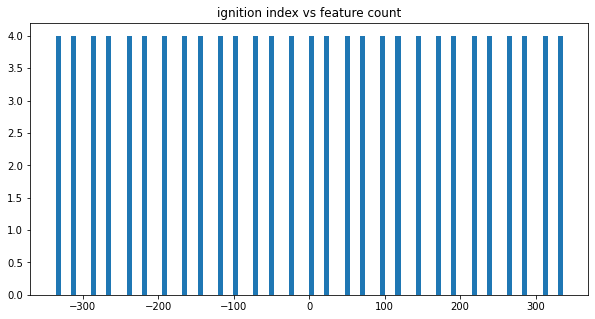

In [ ]:
# let's visualize the distribution of ignition indexes for each absolutely correlated descriptive feature
g = lambda x, f: -x if "_" in f else x # convert to negative for pre-ignition features
ignition_indexes = [g(ignition_index(f), f) for f in abs_corr_specific_list]

fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot(111)
ax.set_title("ignition index vs feature count")
ignition_indexes_hist = plt.hist(x=ignition_indexes, bins=100)

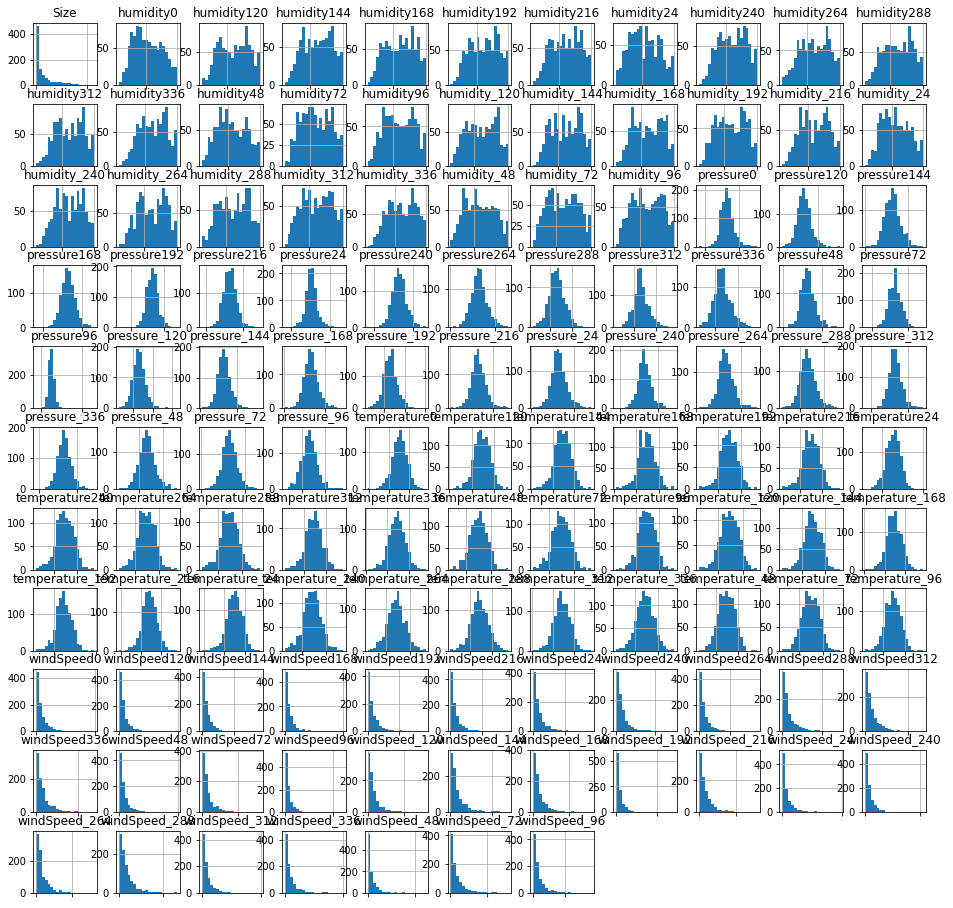

In [ ]:
# View distribution of all descriptive features after outlier and correlation filtering
cdf_hist = cdf[abs_corr_specific_list+["Size"]].hist(bins=20, figsize=(16, 16), xlabelsize=1)

# Feature Engineering

In [ ]:
# Let's construct some polynomial features

training_features = [col for col in cdf.columns.to_list() if "Size" != col]
X = cdf[training_features]

degree = 2
poly = PolynomialFeatures(degree, interaction_only=False, include_bias=False)
fdf = pd.DataFrame(poly.fit_transform(X))

In [ ]:
fdf.head(5)

0     1        2     3      4     5        6     7      8     9  \
0  60.70  0.26  1011.88  0.95  55.87  0.39  1013.39  0.85  53.71  0.44   
1  54.59  0.80  1021.41  0.73  53.39  0.84  1020.50  0.69  51.77  0.82   
2  53.75  0.52  1015.42  5.61  57.99  0.67  1016.50  1.45  54.25  0.87   
3  61.49  0.79  1013.20  0.19  61.79  0.80  1015.19  0.05  62.22  0.81   
4  68.19  0.47  1011.71  1.33  70.49  0.41  1013.20  1.01  64.96  0.60   

        10    11     12    13       14    15     16    17       18    19  \
0  1012.25  1.18  52.32  0.51  1013.54  1.10  52.89  0.41  1011.67  0.74   
1  1020.09  0.29  53.05  0.81  1018.49  1.09  52.51  0.80  1019.81  0.86   
2  1018.80  3.83  61.17  0.59  1020.01  6.23  64.90  0.45  1015.62  4.44   
3  1017.20  1.04  62.10  0.83  1017.31  0.35  60.98  0.86  1013.50  0.00   
4  1013.89  1.12  57.98  0.80  1014.39  0.56  64.32  0.62  1014.29  0.40   

      20    21       22    23     24    25       26    27     28    29  \
0  52.07  0.55  1013.18  0.42  53.54  0.56  1016.78  0.42  57.27  0.57   
1  62.54  0.63  1013.50  2.19  60.71  0.70  1013.41  1.24  58.73  0.78   
2  69.96  0.41  1015.62  4.21  72.36  0.42  1011.50  4.73  73.58  0.22   
3  61.50  0.81  1010.96  0.02  62.08  0.82  1013.85  0.69  63.75  0.82   
4  67.58  0.46  1014.02  0.96  70.83  0.34  1011.71  0.74  67.72  0.39   

        30    31     32    33       34     35     36    37       38    39  \
0  1019.69  0.34  59.85  0.49  1016.50   0.42  60.82  0.41  1014.20  0.70   
1  1017.71  0.48  56.38  0.82  1018.19   0.38  55.92  0.84  1018.80  0.42   
2  1011.79  6.63  70.32  0.38  1014.29  10.15  71.12  0.31  1014.39  7.19   
3  1016.10  0.04  63.85  0.79  1016.15   0.24  64.56  0.75  1013.88  0.44   
4  1011.21  1.43  62.67  0.49  1012.29   0.45  64.32  0.39  1014.70  1.51   

      40    41       42    43     44    45       46    47     48    49  \
0  62.49  0.34  1016.30  0.79  59.07  0.47  1017.05  0.72  60.74  0.45   
1  54.76  0.87  1015.99  0.88  58.82  0.67  1015.29  0.30  61.39  0.80   
2  73.35  0.32  1011.71  2.84  79.55  0.22  1012.91  4.16  79.88  0.25   
3  62.87  0.72  1011.11  0.19  61.75  0.81  1013.36  1.72  60.61  0.77   
4  71.08  0.34  1012.29  0.97  70.13  0.36  1011.11  0.35  73.79  0.26   

        50    51     52    53       54    55     56    57       58    59  \
0  1013.59  0.81  60.75  0.47  1014.62  1.15  60.61  0.43  1015.41  0.75   
1  1015.29  1.33  58.37  0.80  1017.49  0.56  61.12  0.84  1015.99  0.58   
2  1012.40  3.64  81.48  0.25  1010.90  4.30  77.30  0.33  1009.70  2.93   
3  1015.36  1.54  61.25  0.77  1015.46  1.62  59.27  0.80  1017.20  0.14   
4  1009.51  0.49  75.48  0.28  1009.91  0.44  75.31  0.25  1010.90  0.58   

      60    61       62    63     64    65       66    67     68    69  \
0  59.57  0.52  1016.31  1.08  60.75  0.51  1014.13  0.90  60.76  0.49   
1  62.29  0.72  1013.20  0.28  72.12  0.46  1011.50  2.23  73.53  0.48   
2  77.67  0.38  1007.00  3.65  77.30  0.39  1008.40  2.20  78.19  0.37   
3  60.15  0.78  1016.77  0.80  62.64  0.78  1014.99  0.28  59.96  0.88   
4  69.67  0.59  1012.01  1.94  69.01  0.61  1013.89  2.27  62.22  0.53   

        70    71     72    73       74    75     76    77       78    79  \
0  1014.17  0.56  55.55  0.64  1017.98  0.53  56.44  0.37  1020.24  0.52   
1  1008.19  0.85  71.07  0.52  1010.40  0.89  68.14  0.45  1012.29  2.05   
2  1011.21  4.30  76.87  0.45  1011.79  2.97  74.32  0.44  1011.50  5.00   
3  1013.66  0.00  63.43  0.90  1014.16  1.96  64.13  0.85  1015.62  1.31   
4  1014.90  0.96  58.07  0.63  1014.99  0.92  56.27  0.72  1014.51  3.03   

      80    81       82    83     84    85       86    87     88    89  \
0  55.48  0.26  1017.76  0.61  54.78  0.38  1014.92  0.60  54.42  0.45   
1  67.77  0.54  1013.71  0.55  62.07  0.72  1017.38  1.33  64.52  0.68   
2  72.14  0.43  1011.00  3.92  71.74  0.47  1011.29  2.09  72.25  0.49   
3  62.96  0.91  1015.32  1.74  64.06  0.78  1013.22  0.12  62.10  0.77   
4  53.58  0.59  1013.50

In [ ]:
new_feature_names = poly.get_feature_names(input_features=training_features)
print(len(new_feature_names))
new_feature_names

6902


['temperature_336',
 'humidity_336',
 'pressure_336',
 'windSpeed_336',
 'temperature_312',
 'humidity_312',
 'pressure_312',
 'windSpeed_312',
 'temperature_288',
 'humidity_288',
 'pressure_288',
 'windSpeed_288',
 'temperature_264',
 'humidity_264',
 'pressure_264',
 'windSpeed_264',
 'temperature_240',
 'humidity_240',
 'pressure_240',
 'windSpeed_240',
 'temperature_216',
 'humidity_216',
 'pressure_216',
 'windSpeed_216',
 'temperature_192',
 'humidity_192',
 'pressure_192',
 'windSpeed_192',
 'temperature_168',
 'humidity_168',
 'pressure_168',
 'windSpeed_168',
 'temperature_144',
 'humidity_144',
 'pressure_144',
 'windSpeed_144',
 'temperature_120',
 'humidity_120',
 'pressure_120',
 'windSpeed_120',
 'temperature_96',
 'humidity_96',
 'pressure_96',
 'windSpeed_96',
 'temperature_72',
 'humidity_72',
 'pressure_72',
 'windSpeed_72',
 'temperature_48',
 'humidity_48',
 'pressure_48',
 'windSpeed_48',
 'temperature_24',
 'humidity_24',
 'pressure_24',
 'windSpeed_24',
 'temper

In [ ]:
fdf.columns = new_feature_names
fdf["Size"] = cdf["Size"]

In [ ]:
fdf.head(5)

,temperature_336,humidity_336,pressure_336,windSpeed_336,temperature_312,humidity_312,pressure_312,windSpeed_312,temperature_288,humidity_288,pressure_288,windSpeed_288,temperature_264,humidity_264,pressure_264,windSpeed_264,temperature_240,humidity_240,pressure_240,windSpeed_240,temperature_216,humidity_216,pressure_216,windSpeed_216,temperature_192,humidity_192,pressure_192,windSpeed_192,temperature_168,humidity_168,pressure_168,windSpeed_168,temperature_144,humidity_144,pressure_144,windSpeed_144,temperature_120,humidity_120,pressure_120,windSpeed_120,temperature_96,humidity_96,pressure_96,windSpeed_96,temperature_72,humidity_72,pressure_72,windSpeed_72,temperature_48,humidity_48,pressure_48,windSpeed_48,temperature_24,humidity_24,pressure_24,windSpeed_24,temperature0,humidity0,pressure0,windSpeed0,temperature24,humidity24,pressure24,windSpeed24,temperature48,humidity48,pressure48,windSpeed48,temperature72,humidity72,pressure72,windSpeed72,temperature96,humidity96,pressure96,windSpeed96,temperature120,humidity120,pressure120,windSpeed120,temperature144,humidity144,pressure144,windSpeed144,temperature168,humidity168,pressure168,windSpeed168,temperature192,humidity192,pressure192,windSpeed192,temperature216,humidity216,pressure216,windSpeed216,temperature240,humidity240,pressure240,windSpeed240,temperature264,humidity264,pressure264,windSpeed264,temperature288,humidity288,pressure288,windSpeed288,temperature312,humidity312,pressure312,windSpeed312,temperature336,humidity336,pressure336,windSpeed336,temperature_336^2,temperature_336 humidity_336,temperature_336 pressure_336,temperature_336 windSpeed_336,temperature_336 temperature_312,temperature_336 humidity_312,temperature_336 pressure_312,temperature_336 windSpeed_312,temperature_336 temperature_288,temperature_336 humidity_288,temperature_336 pressure_288,temperature_336 windSpeed_288,temperature_336 temperature_264,temperature_336 humidity_264,temperature_336 pressure_264,temperature_336 windSpeed_264,temperature_336 temperature_240,temperature_336 humidity_240,temperature_336 pressure_240,temperature_336 windSpeed_240,temperature_336 temperature_216,temperature_336 humidity_216,temperature_336 pressure_216,temperature_336 windSpeed_216,temperature_336 temperature_192,temperature_336 humidity_192,temperature_336 pressure_192,temperature_336 windSpeed_192,temperature_336 temperature_168,temperature_336 humidity_168,temperature_336 pressure_168,temperature_336 windSpeed_168,temperature_336 temperature_144,temperature_336 humidity_144,temperature_336 pressure_144,temperature_336 windSpeed_144,temperature_336 temperature_120,temperature_336 humidity_120,temperature_336 pressure_120,temperature_336 windSpeed_120,temperature_336 temperature_96,temperature_336 humidity_96,temperature_336 pressure_96,temperature_336 windSpeed_96,temperature_336 temperature_72,temperature_336 humidity_72,temperature_336 pressure_72,temperature_336 windSpeed_72,temperature_336 temperature_48,temperature_336 humidity_48,temperature_336 pressure_48,temperature_336 windSpeed_48,temperature_336 temperature_24,temperature_336 humidity_24,temperature_336 pressure_24,temperature_336 windSpeed_24,temperature_336 temperature0,temperature_336 humidity0,temperature_336 pressure0,temperature_336 windSpeed0,temperature_336 temperature24,temperature_336 humidity24,temperature_336 pressure24,temperature_336 windSpeed24,temperature_336 temperature48,temperature_336 humidity48,temperature_336 pressure48,temperature_336 windSpeed48,temperature_336 temperature72,temperature_336 humidity72,temperature_336 pressure72,temperature_336 windSpeed72,temperature_336 temperature96,temperature_336 humidity96,temperature_336 pressure96,temperature_336 windSpeed96,temperature_336 temperature120,temperature_336 humidity120,temperature_336 pressure120,temperature_336 windSpeed120,temperature_336 temperature144,temperature_336 humidity144,temperature_336 pressure144,temperature_336 windSpeed144,temperature_336 temperature168,temper

In [ ]:
# Find and remove all redundant polynomial features (shouldn't need with lasso)

# correlated_features = set()
# correlation_matrix = fdf.drop("Size", axis=1).corr() # remove target feature
# correlation_threshold = 0.9 # two features' correlation coefficient should be <

# # find all pair-wise correlated descriptive features via their Pearson correlation
# for i in range(len(correlation_matrix.columns)):
#     for j in range(i):
#         if abs(correlation_matrix.iloc[i, j]) > correlation_threshold:
#             colname = correlation_matrix.columns[i]
#             correlated_features.add(colname)

# # the outlier-reduced dataframe with non pair-wise correlated descriptive features
# cfdf = fdf.drop(correlated_features, axis=1).reset_index(drop=True)
cfdf = fdf.reset_index(drop=True)

# print(str(len(correlated_features))+" features removed from "+str(len(fdf.columns))+" total:")
# print(sorted(list(correlated_features)))
# print("\n")
# print(str(len(cfdf.columns))+" features remaining:")
# print(sorted(cfdf.columns.to_list()))

In [ ]:
cfdf.head(5)

,temperature_336,humidity_336,pressure_336,windSpeed_336,temperature_312,humidity_312,pressure_312,windSpeed_312,temperature_288,humidity_288,pressure_288,windSpeed_288,temperature_264,humidity_264,pressure_264,windSpeed_264,temperature_240,humidity_240,pressure_240,windSpeed_240,temperature_216,humidity_216,pressure_216,windSpeed_216,temperature_192,humidity_192,pressure_192,windSpeed_192,temperature_168,humidity_168,pressure_168,windSpeed_168,temperature_144,humidity_144,pressure_144,windSpeed_144,temperature_120,humidity_120,pressure_120,windSpeed_120,temperature_96,humidity_96,pressure_96,windSpeed_96,temperature_72,humidity_72,pressure_72,windSpeed_72,temperature_48,humidity_48,pressure_48,windSpeed_48,temperature_24,humidity_24,pressure_24,windSpeed_24,temperature0,humidity0,pressure0,windSpeed0,temperature24,humidity24,pressure24,windSpeed24,temperature48,humidity48,pressure48,windSpeed48,temperature72,humidity72,pressure72,windSpeed72,temperature96,humidity96,pressure96,windSpeed96,temperature120,humidity120,pressure120,windSpeed120,temperature144,humidity144,pressure144,windSpeed144,temperature168,humidity168,pressure168,windSpeed168,temperature192,humidity192,pressure192,windSpeed192,temperature216,humidity216,pressure216,windSpeed216,temperature240,humidity240,pressure240,windSpeed240,temperature264,humidity264,pressure264,windSpeed264,temperature288,humidity288,pressure288,windSpeed288,temperature312,humidity312,pressure312,windSpeed312,temperature336,humidity336,pressure336,windSpeed336,temperature_336^2,temperature_336 humidity_336,temperature_336 pressure_336,temperature_336 windSpeed_336,temperature_336 temperature_312,temperature_336 humidity_312,temperature_336 pressure_312,temperature_336 windSpeed_312,temperature_336 temperature_288,temperature_336 humidity_288,temperature_336 pressure_288,temperature_336 windSpeed_288,temperature_336 temperature_264,temperature_336 humidity_264,temperature_336 pressure_264,temperature_336 windSpeed_264,temperature_336 temperature_240,temperature_336 humidity_240,temperature_336 pressure_240,temperature_336 windSpeed_240,temperature_336 temperature_216,temperature_336 humidity_216,temperature_336 pressure_216,temperature_336 windSpeed_216,temperature_336 temperature_192,temperature_336 humidity_192,temperature_336 pressure_192,temperature_336 windSpeed_192,temperature_336 temperature_168,temperature_336 humidity_168,temperature_336 pressure_168,temperature_336 windSpeed_168,temperature_336 temperature_144,temperature_336 humidity_144,temperature_336 pressure_144,temperature_336 windSpeed_144,temperature_336 temperature_120,temperature_336 humidity_120,temperature_336 pressure_120,temperature_336 windSpeed_120,temperature_336 temperature_96,temperature_336 humidity_96,temperature_336 pressure_96,temperature_336 windSpeed_96,temperature_336 temperature_72,temperature_336 humidity_72,temperature_336 pressure_72,temperature_336 windSpeed_72,temperature_336 temperature_48,temperature_336 humidity_48,temperature_336 pressure_48,temperature_336 windSpeed_48,temperature_336 temperature_24,temperature_336 humidity_24,temperature_336 pressure_24,temperature_336 windSpeed_24,temperature_336 temperature0,temperature_336 humidity0,temperature_336 pressure0,temperature_336 windSpeed0,temperature_336 temperature24,temperature_336 humidity24,temperature_336 pressure24,temperature_336 windSpeed24,temperature_336 temperature48,temperature_336 humidity48,temperature_336 pressure48,temperature_336 windSpeed48,temperature_336 temperature72,temperature_336 humidity72,temperature_336 pressure72,temperature_336 windSpeed72,temperature_336 temperature96,temperature_336 humidity96,temperature_336 pressure96,temperature_336 windSpeed96,temperature_336 temperature120,temperature_336 humidity120,temperature_336 pressure120,temperature_336 windSpeed120,temperature_336 temperature144,temperature_336 humidity144,temperature_336 pressure144,temperature_336 windSpeed144,temperature_336 temperature168,temper

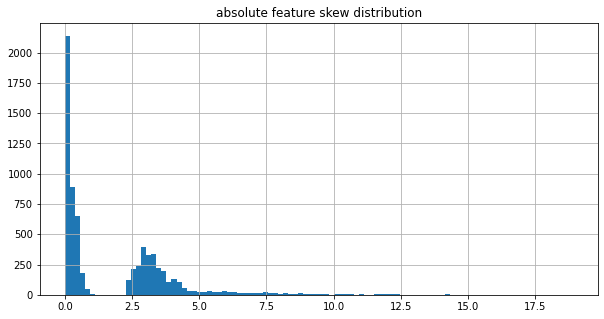

In [ ]:
# Looks like some features are a bit skewed, let's see their distribution (want cluster close to 0)
fig = plt.figure(figsize=(10, 5))
ax = fig.add_subplot(111)
ax.set_title("absolute feature skew distribution")
skew_df = pd.DataFrame(cfdf.skew())
skew_df.index.name="feature"
skew_df.columns=["skew"]
skew_df["skew"] = skew_df["skew"].map(abs)
skew_hist = skew_df["skew"].hist(bins=100, xlabelsize=10)

In [ ]:
# let's rank each feature combination by its mean absolute skew
skew_df.index = skew_df.index.map(indexed_feature_to_feature)
skew_df = skew_df.groupby("feature", sort=False)[["skew"]].mean().sort_values("skew",ascending=False)
skew_df

,skew
feature,
windSpeed^2,8.104431
windSpeed windSpeed,7.715798
humidity windSpeed,3.727408
temperature windSpeed,3.192390
windSpeed,2.987552
pressure windSpeed,2.985249
Size,1.944642
humidity humidity,0.561600
humidity^2,0.485113


## Feature Normalization

In [ ]:
cfdf.head(5)

feature,temperature_336,humidity_336,pressure_336,windSpeed_336,temperature_312,humidity_312,pressure_312,windSpeed_312,temperature_288,humidity_288,pressure_288,windSpeed_288,temperature_264,humidity_264,pressure_264,windSpeed_264,temperature_240,humidity_240,pressure_240,windSpeed_240,temperature_216,humidity_216,pressure_216,windSpeed_216,temperature_192,humidity_192,pressure_192,windSpeed_192,temperature_168,humidity_168,pressure_168,windSpeed_168,temperature_144,humidity_144,pressure_144,windSpeed_144,temperature_120,humidity_120,pressure_120,windSpeed_120,temperature_96,humidity_96,pressure_96,windSpeed_96,temperature_72,humidity_72,pressure_72,windSpeed_72,temperature_48,humidity_48,pressure_48,windSpeed_48,temperature_24,humidity_24,pressure_24,windSpeed_24,temperature0,humidity0,pressure0,windSpeed0,temperature24,humidity24,pressure24,windSpeed24,temperature48,humidity48,pressure48,windSpeed48,temperature72,humidity72,pressure72,windSpeed72,temperature96,humidity96,pressure96,windSpeed96,temperature120,humidity120,pressure120,windSpeed120,temperature144,humidity144,pressure144,windSpeed144,temperature168,humidity168,pressure168,windSpeed168,temperature192,humidity192,pressure192,windSpeed192,temperature216,humidity216,pressure216,windSpeed216,temperature240,humidity240,pressure240,windSpeed240,temperature264,humidity264,pressure264,windSpeed264,temperature288,humidity288,pressure288,windSpeed288,temperature312,humidity312,pressure312,windSpeed312,temperature336,humidity336,pressure336,windSpeed336,temperature_336^2,temperature_336 humidity_336,temperature_336 pressure_336,temperature_336 windSpeed_336,temperature_336 temperature_312,temperature_336 humidity_312,temperature_336 pressure_312,temperature_336 windSpeed_312,temperature_336 temperature_288,temperature_336 humidity_288,temperature_336 pressure_288,temperature_336 windSpeed_288,temperature_336 temperature_264,temperature_336 humidity_264,temperature_336 pressure_264,temperature_336 windSpeed_264,temperature_336 temperature_240,temperature_336 humidity_240,temperature_336 pressure_240,temperature_336 windSpeed_240,temperature_336 temperature_216,temperature_336 humidity_216,temperature_336 pressure_216,temperature_336 windSpeed_216,temperature_336 temperature_192,temperature_336 humidity_192,temperature_336 pressure_192,temperature_336 windSpeed_192,temperature_336 temperature_168,temperature_336 humidity_168,temperature_336 pressure_168,temperature_336 windSpeed_168,temperature_336 temperature_144,temperature_336 humidity_144,temperature_336 pressure_144,temperature_336 windSpeed_144,temperature_336 temperature_120,temperature_336 humidity_120,temperature_336 pressure_120,temperature_336 windSpeed_120,temperature_336 temperature_96,temperature_336 humidity_96,temperature_336 pressure_96,temperature_336 windSpeed_96,temperature_336 temperature_72,temperature_336 humidity_72,temperature_336 pressure_72,temperature_336 windSpeed_72,temperature_336 temperature_48,temperature_336 humidity_48,temperature_336 pressure_48,temperature_336 windSpeed_48,temperature_336 temperature_24,temperature_336 humidity_24,temperature_336 pressure_24,temperature_336 windSpeed_24,temperature_336 temperature0,temperature_336 humidity0,temperature_336 pressure0,temperature_336 windSpeed0,temperature_336 temperature24,temperature_336 humidity24,temperature_336 pressure24,temperature_336 windSpeed24,temperature_336 temperature48,temperature_336 humidity48,temperature_336 pressure48,temperature_336 windSpeed48,temperature_336 temperature72,temperature_336 humidity72,temperature_336 pressure72,temperature_336 windSpeed72,temperature_336 temperature96,temperature_336 humidity96,temperature_336 pressure96,temperature_336 windSpeed96,temperature_336 temperature120,temperature_336 humidity120,temperature_336 pressure120,temperature_336 windSpeed120,temperature_336 temperature144,temperature_336 humidity144,temperature_336 pressure144,temperature_336 windSpeed144,temperature_336 temperature168

In [ ]:
# cfdf.describe()

In [ ]:
# Let's normalize the outlier-reduced correlation-filtered polynomial features
ndf, params, scaler = transform(cfdf, "Size")

In [ ]:
ndf.head(5)

,temperature_336,humidity_336,pressure_336,windSpeed_336,temperature_312,humidity_312,pressure_312,windSpeed_312,temperature_288,humidity_288,pressure_288,windSpeed_288,temperature_264,humidity_264,pressure_264,windSpeed_264,temperature_240,humidity_240,pressure_240,windSpeed_240,temperature_216,humidity_216,pressure_216,windSpeed_216,temperature_192,humidity_192,pressure_192,windSpeed_192,temperature_168,humidity_168,pressure_168,windSpeed_168,temperature_144,humidity_144,pressure_144,windSpeed_144,temperature_120,humidity_120,pressure_120,windSpeed_120,temperature_96,humidity_96,pressure_96,windSpeed_96,temperature_72,humidity_72,pressure_72,windSpeed_72,temperature_48,humidity_48,pressure_48,windSpeed_48,temperature_24,humidity_24,pressure_24,windSpeed_24,temperature0,humidity0,pressure0,windSpeed0,temperature24,humidity24,pressure24,windSpeed24,temperature48,humidity48,pressure48,windSpeed48,temperature72,humidity72,pressure72,windSpeed72,temperature96,humidity96,pressure96,windSpeed96,temperature120,humidity120,pressure120,windSpeed120,temperature144,humidity144,pressure144,windSpeed144,temperature168,humidity168,pressure168,windSpeed168,temperature192,humidity192,pressure192,windSpeed192,temperature216,humidity216,pressure216,windSpeed216,temperature240,humidity240,pressure240,windSpeed240,temperature264,humidity264,pressure264,windSpeed264,temperature288,humidity288,pressure288,windSpeed288,temperature312,humidity312,pressure312,windSpeed312,temperature336,humidity336,pressure336,windSpeed336,temperature_336^2,temperature_336 humidity_336,temperature_336 pressure_336,temperature_336 windSpeed_336,temperature_336 temperature_312,temperature_336 humidity_312,temperature_336 pressure_312,temperature_336 windSpeed_312,temperature_336 temperature_288,temperature_336 humidity_288,temperature_336 pressure_288,temperature_336 windSpeed_288,temperature_336 temperature_264,temperature_336 humidity_264,temperature_336 pressure_264,temperature_336 windSpeed_264,temperature_336 temperature_240,temperature_336 humidity_240,temperature_336 pressure_240,temperature_336 windSpeed_240,temperature_336 temperature_216,temperature_336 humidity_216,temperature_336 pressure_216,temperature_336 windSpeed_216,temperature_336 temperature_192,temperature_336 humidity_192,temperature_336 pressure_192,temperature_336 windSpeed_192,temperature_336 temperature_168,temperature_336 humidity_168,temperature_336 pressure_168,temperature_336 windSpeed_168,temperature_336 temperature_144,temperature_336 humidity_144,temperature_336 pressure_144,temperature_336 windSpeed_144,temperature_336 temperature_120,temperature_336 humidity_120,temperature_336 pressure_120,temperature_336 windSpeed_120,temperature_336 temperature_96,temperature_336 humidity_96,temperature_336 pressure_96,temperature_336 windSpeed_96,temperature_336 temperature_72,temperature_336 humidity_72,temperature_336 pressure_72,temperature_336 windSpeed_72,temperature_336 temperature_48,temperature_336 humidity_48,temperature_336 pressure_48,temperature_336 windSpeed_48,temperature_336 temperature_24,temperature_336 humidity_24,temperature_336 pressure_24,temperature_336 windSpeed_24,temperature_336 temperature0,temperature_336 humidity0,temperature_336 pressure0,temperature_336 windSpeed0,temperature_336 temperature24,temperature_336 humidity24,temperature_336 pressure24,temperature_336 windSpeed24,temperature_336 temperature48,temperature_336 humidity48,temperature_336 pressure48,temperature_336 windSpeed48,temperature_336 temperature72,temperature_336 humidity72,temperature_336 pressure72,temperature_336 windSpeed72,temperature_336 temperature96,temperature_336 humidity96,temperature_336 pressure96,temperature_336 windSpeed96,temperature_336 temperature120,temperature_336 humidity120,temperature_336 pressure120,temperature_336 windSpeed120,temperature_336 temperature144,temperature_336 humidity144,temperature_336 pressure144,temperature_336 windSpeed144,temperature_336 temperature168,temper

In [ ]:
inv_box_cox_transform([8.578036],**params["Size"])[0][0]

655.0000320056018

In [ ]:
ndf.describe()

,temperature_336,humidity_336,pressure_336,windSpeed_336,temperature_312,humidity_312,pressure_312,windSpeed_312,temperature_288,humidity_288,pressure_288,windSpeed_288,temperature_264,humidity_264,pressure_264,windSpeed_264,temperature_240,humidity_240,pressure_240,windSpeed_240,temperature_216,humidity_216,pressure_216,windSpeed_216,temperature_192,humidity_192,pressure_192,windSpeed_192,temperature_168,humidity_168,pressure_168,windSpeed_168,temperature_144,humidity_144,pressure_144,windSpeed_144,temperature_120,humidity_120,pressure_120,windSpeed_120,temperature_96,humidity_96,pressure_96,windSpeed_96,temperature_72,humidity_72,pressure_72,windSpeed_72,temperature_48,humidity_48,pressure_48,windSpeed_48,temperature_24,humidity_24,pressure_24,windSpeed_24,temperature0,humidity0,pressure0,windSpeed0,temperature24,humidity24,pressure24,windSpeed24,temperature48,humidity48,pressure48,windSpeed48,temperature72,humidity72,pressure72,windSpeed72,temperature96,humidity96,pressure96,windSpeed96,temperature120,humidity120,pressure120,windSpeed120,temperature144,humidity144,pressure144,windSpeed144,temperature168,humidity168,pressure168,windSpeed168,temperature192,humidity192,pressure192,windSpeed192,temperature216,humidity216,pressure216,windSpeed216,temperature240,humidity240,pressure240,windSpeed240,temperature264,humidity264,pressure264,windSpeed264,temperature288,humidity288,pressure288,windSpeed288,temperature312,humidity312,pressure312,windSpeed312,temperature336,humidity336,pressure336,windSpeed336,temperature_336^2,temperature_336 humidity_336,temperature_336 pressure_336,temperature_336 windSpeed_336,temperature_336 temperature_312,temperature_336 humidity_312,temperature_336 pressure_312,temperature_336 windSpeed_312,temperature_336 temperature_288,temperature_336 humidity_288,temperature_336 pressure_288,temperature_336 windSpeed_288,temperature_336 temperature_264,temperature_336 humidity_264,temperature_336 pressure_264,temperature_336 windSpeed_264,temperature_336 temperature_240,temperature_336 humidity_240,temperature_336 pressure_240,temperature_336 windSpeed_240,temperature_336 temperature_216,temperature_336 humidity_216,temperature_336 pressure_216,temperature_336 windSpeed_216,temperature_336 temperature_192,temperature_336 humidity_192,temperature_336 pressure_192,temperature_336 windSpeed_192,temperature_336 temperature_168,temperature_336 humidity_168,temperature_336 pressure_168,temperature_336 windSpeed_168,temperature_336 temperature_144,temperature_336 humidity_144,temperature_336 pressure_144,temperature_336 windSpeed_144,temperature_336 temperature_120,temperature_336 humidity_120,temperature_336 pressure_120,temperature_336 windSpeed_120,temperature_336 temperature_96,temperature_336 humidity_96,temperature_336 pressure_96,temperature_336 windSpeed_96,temperature_336 temperature_72,temperature_336 humidity_72,temperature_336 pressure_72,temperature_336 windSpeed_72,temperature_336 temperature_48,temperature_336 humidity_48,temperature_336 pressure_48,temperature_336 windSpeed_48,temperature_336 temperature_24,temperature_336 humidity_24,temperature_336 pressure_24,temperature_336 windSpeed_24,temperature_336 temperature0,temperature_336 humidity0,temperature_336 pressure0,temperature_336 windSpeed0,temperature_336 temperature24,temperature_336 humidity24,temperature_336 pressure24,temperature_336 windSpeed24,temperature_336 temperature48,temperature_336 humidity48,temperature_336 pressure48,temperature_336 windSpeed48,temperature_336 temperature72,temperature_336 humidity72,temperature_336 pressure72,temperature_336 windSpeed72,temperature_336 temperature96,temperature_336 humidity96,temperature_336 pressure96,temperature_336 windSpeed96,temperature_336 temperature120,temperature_336 humidity120,temperature_336 pressure120,temperature_336 windSpeed120,temperature_336 temperature144,temperature_336 humidity144,temperature_336 pressure144,temperature_336 windSpeed144,temperature_336 temperature168,temper

In [ ]:
# Test inverse transforming
un = unnormalize(ndf, "Size", params, scaler) # should look like cfdf

In [ ]:
# un.head(5)

In [ ]:
# un.describe()

In [ ]:
"""
The Box-Cox transform is given by:

y = (x**lmbda - 1) / lmbda,  for lmbda > 0
    log(x),                  for lmbda = 0
"""
# params['Size'] # lmbda = 0.08253054892104245 (if transformed)
params

{'temperature_336': {'lmbda': 1.076948879388775, 'min_val': 30.06},
 'humidity_336': {'lmbda': 1.1994053156314994, 'min_val': 0.06},
 'pressure_336': {'lmbda': 0.8540654085064656, 'min_val': 998.5},
 'windSpeed_336': {'lmbda': -0.6665256010776338, 'min_val': 0.0},
 'temperature_312': {'lmbda': 1.0908241799259693, 'min_val': 26.61},
 'humidity_312': {'lmbda': 0.920606638670661, 'min_val': 0.14},
 'pressure_312': {'lmbda': 0.7898970979623924, 'min_val': 996.7},
 'windSpeed_312': {'lmbda': -0.6410557520017297, 'min_val': 0.0},
 'temperature_288': {'lmbda': 1.0677601473575435, 'min_val': 28.45},
 'humidity_288': {'lmbda': 1.1629668269954911, 'min_val': 0.15},
 'pressure_288': {'lmbda': 0.7693036665092036, 'min_val': 1002.64},
 'windSpeed_288': {'lmbda': -0.5917976052137526, 'min_val': 0.0},
 'temperature_264': {'lmbda': 0.9835865125071686, 'min_val': 30.23},
 'humidity_264': {'lmbda': 1.2423289704234113, 'min_val': 0.11},
 'pressure_264': {'lmbda': 0.7492884273897886, 'min_val': 1001.25},


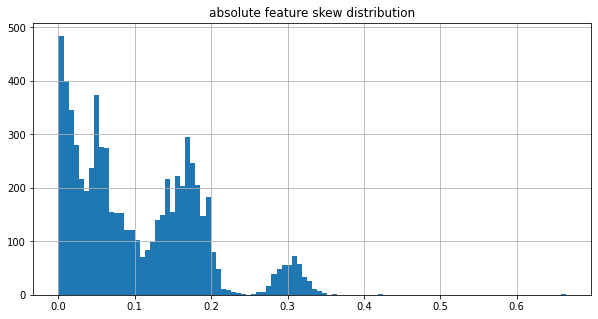

In [ ]:
# Looks like we fixed the skew for some features, let's see their distribution (want cluster close to 0)
fig = plt.figure(figsize=(10, 5))
ax = fig.add_subplot(111)
ax.set_title("absolute feature skew distribution")
norm_skew_df = pd.DataFrame(ndf.skew(), columns=["skew"])
norm_skew_df.index.name="feature"
norm_skew_df["skew"] = norm_skew_df["skew"].map(abs)
norm_skew_hist = norm_skew_df["skew"].hist(bins=100, xlabelsize=10)
norm_skew_df = norm_skew_df.sort_values("skew",ascending=False)

In [ ]:
# Now let's rank each feature combination by its mean absolute skew
norm_skew_df.index = norm_skew_df.index.map(indexed_feature_to_feature)
norm_skew_df = norm_skew_df.groupby("feature", sort=False)[["skew"]].mean().sort_values("skew",ascending=False)
norm_skew_df

,skew
feature,
windSpeed^2,0.308658
windSpeed windSpeed,0.303861
humidity windSpeed,0.180012
humidity pressure,0.163744
humidity temperature,0.137391
pressure,0.115825
pressure^2,0.115714
windSpeed,0.113747
pressure pressure,0.094848


In [ ]:
# Which feature combinations benefitted most from normalization?
skew_diff_df = pd.DataFrame({"normalized_skew": norm_skew_df["skew"], "unnormalized_skew": skew_df["skew"]})
skew_diff_df["diff"] = skew_diff_df["unnormalized_skew"]-skew_diff_df["normalized_skew"]
skew_diff_df.sort_values(["diff","normalized_skew"],ascending=False)

,normalized_skew,unnormalized_skew,diff
windSpeed^2,0.308658,8.104431,7.795773
windSpeed windSpeed,0.303861,7.715798,7.411936
humidity windSpeed,0.180012,3.727408,3.547396
temperature windSpeed,0.009130,3.192390,3.183260
pressure windSpeed,0.063479,2.985249,2.921770
windSpeed,0.113747,2.987552,2.873805
Size,0.037100,1.944642,1.907542
humidity humidity,0.067401,0.561600,0.494199
humidity^2,0.057763,0.485113,0.427350
pressure pressure,0.094848,0.460885,0.366037


## Dimensionality Reduction

In [ ]:
def pca(X, pc):
    """
    Perform principal component analysis, returning the transformed X with the first pc components.
    """
    pca = PCA()
    # z-score normalize each feature in the dataframe
    X_standardized = StandardScaler().fit_transform(X)
    X_pca = pca.fit_transform(X_standardized)[:,:pc]
    return X_pca

def test_pca():
    training_features = [col for col in ndf.columns.to_list() if col != "Size"]
    training_target = "Size"
    X = ndf[training_features]
    res = pca(X, 4)
#     pca_df = pd.DataFrame(res)
#     print(pca_df)

def pcr(X, Y, pc):
    """
    Performs principal component regression using the given number of components.
    """
    X_pca = pca(X, pc)
    
    model = linear_model.LinearRegression()

    model.fit(X_pca, Y)
    Y_pred = model.predict(X_pca)
    
    # cross-validation, divide data by cv and hold out one part for cross-validation
    Y_pred_cv = cross_val_predict(model, X_pca, Y, cv=10)

    # how close are we?
    rsq = model.score(X_pca, Y)
    rsq_pred = r2_score(Y, Y_pred)
    rsq_pred_cv = r2_score(Y, Y_pred_cv)
    mae_pred = metrics.mean_absolute_error(Y, Y_pred)
    mae_pred_cv = metrics.mean_absolute_error(Y, Y_pred_cv)
    rmse_pred = math.sqrt(mean_squared_error(Y, Y_pred))
    rmse_pred_cv = math.sqrt(mean_squared_error(Y, Y_pred_cv))

    res = {
        "pc": pc,
        "r_sq": rsq,
        "rsq_pred": rsq_pred,
        "rsq_pred_cv": rsq_pred_cv,
        "mae_pred": mae_pred,
        "mae_pred_cv": mae_pred_cv,
        "rmse_pred": rmse_pred,
        "rmse_pred_cv": rmse_pred_cv
    }
    return res

In [ ]:
# Let's find the optimal number of principal components

def get_best_pca(X, Y, upper_components):
    """
    Performs PCA on the input dataframe using the optimal number of components
    found to minimize cross validation error, using at most the given number of components.
    """
    print("Finding best PCA configuration...\n")
    s_rsq_pred = []
    s_rsq_pred_cv = []
    s_rmse_pred = []
    s_rmse_pred_cv = []

    runs = []
    for pc in range(1,upper_components+1):
        res = pcr(X, Y, pc)
        runs.append(res)
        s_rsq_pred.append(res["rsq_pred"])
        s_rsq_pred_cv.append(res["rsq_pred_cv"])
        s_rmse_pred.append(res["rmse_pred"])
        s_rmse_pred_cv.append(res["rmse_pred_cv"])

    def run_comparator(r1, r2):
        if r1["rmse_pred_cv"] < r2["rmse_pred_cv"]:
            return -1
        elif r1["rmse_pred_cv"] > r2["rmse_pred_cv"]:
            return 1
        else:
            return 0

    best_run = sorted(runs, key=cmp_to_key(run_comparator))[0]
    print("Best configuration uses "+str(best_run["pc"])+" component(s) and gives the following metrics:")
    print(pd.DataFrame(best_run, index=[0]).to_string(index=False))

    rsq_df = pd.DataFrame({"rsq_pred": s_rsq_pred, "rsq_pred_cv": s_rsq_pred_cv})
    rmse_df = pd.DataFrame({"rmse_pred": s_rmse_pred, "rmse_pred_cv": s_rmse_pred_cv})
    pdf = pd.DataFrame(pca(X, best_run["pc"]))
    pdf["Size"] = Y
    return pdf, rsq_df, rmse_df, best_run

Finding best PCA configuration...

Best configuration uses 8 component(s) and gives the following metrics:
 pc      r_sq  rsq_pred  rsq_pred_cv  mae_pred  mae_pred_cv  rmse_pred  rmse_pred_cv
  8  0.062638  0.062638     0.032082  0.809344     0.822746   0.968175      0.983828


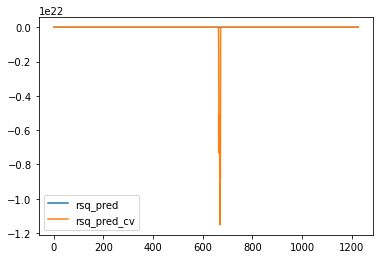

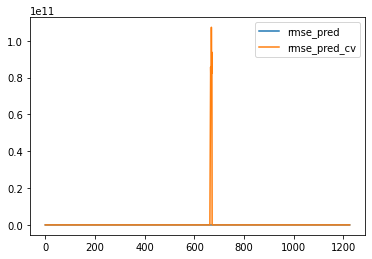

In [ ]:
training_features = [col for col in ndf.columns.to_list() if col != "Size"]
training_target = "Size"
X = ndf[training_features].to_numpy()
Y = ndf[training_target].values.reshape(-1, 1)

total_possible_components = len(training_features)
upper_components = total_possible_components

pdf, rsq_df, rmse_df, best_run = get_best_pca(X, Y, upper_components)

p1 = rsq_df.plot()
p2 = rmse_df.plot()

In [ ]:
pdf.head(5)

,0,1,2,3,4,5,6,7,Size
0,44.427703,0.439535,-4.652068,4.940736,5.595608,1.293408,-2.209067,-1.066250,-0.710112
1,48.901012,2.169993,0.963323,-5.935284,0.937803,2.556975,-2.309023,2.643766,0.929430
2,11.523961,14.524208,-0.943693,0.253661,0.903188,5.712962,-3.603924,-1.813761,-0.710112
3,-29.083818,11.005434,0.335295,0.774802,-0.096304,-0.498655,-0.934017,6.447579,-0.558171
4,-19.957173,0.824809,4.248112,-0.823521,-3.130269,0.126466,-2.261706,-1.055560,-0.197939


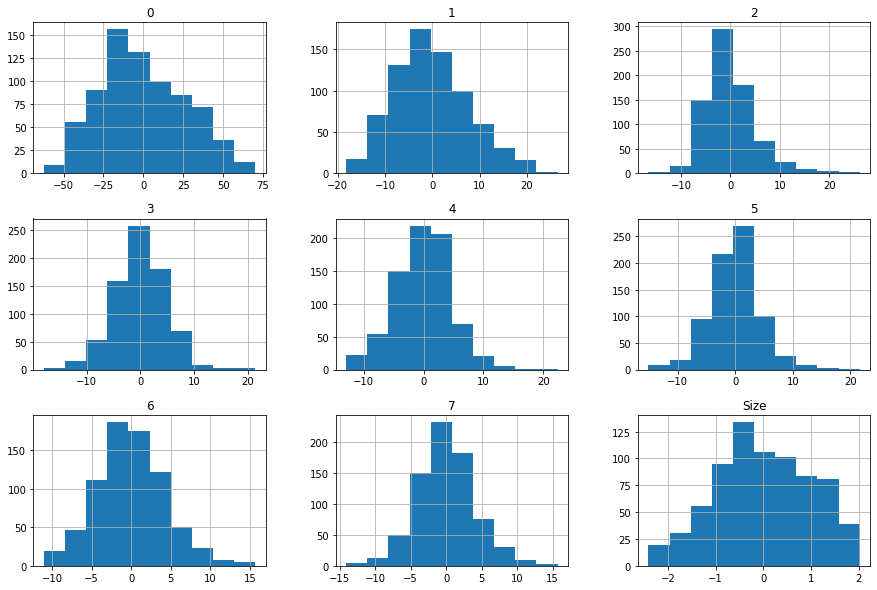

In [ ]:
pdf_plot = pdf.hist(figsize=(15,10))

# Create Data Splits

In [ ]:
# Create data splits using the outlier-reduced feature-filtered normalized dataframe

X_train_df,y_train_df,X_valid_df,y_valid_df,X_test_df,y_test_df,y_all_df = get_split(ndf, ndf.columns.to_list())
# X_train_df,y_train_df,X_valid_df,y_valid_df,X_test_df,y_test_df,y_all_df = get_split(pdf, pdf.columns.to_list())

# # Create new run (indexed by current date and time)
# RUN_NAME = 'run_'+datetime.now().strftime("%Y%m%d_%H%M%S")

# # data folder
# outdir = './data/'+RUN_NAME

# if not os.path.exists(outdir):
#     os.mkdir(outdir)

# def output(data, filename):
#     data.to_csv(outdir+"/"+filename, header="False")

# output(all_df, "all_data.csv")
# output(ndf, "ndf.csv")

# # export data splits to csv
# output(X_train_df, "X_train.csv")
# output(y_train_df, "y_train.csv")
# output(X_valid_df, "X_valid.csv")
# output(y_valid_df, "y_valid.csv")
# output(X_test_df, "X_test.csv")
# output(y_test_df, "y_test.csv")
# output(y_all_df, "y_all.csv")

# # create metrics file
# with open(outdir+"/metrics_"+RUN_NAME+".txt", "w") as text_file:
#     # summarize distribution of target feature for each data split
#     text_file.write("Training targets summary:\n")
#     text_file.write(y_train_df.describe().to_string()+'\n\n')
#     text_file.write("Validation targets summary:\n")
#     text_file.write(y_valid_df.describe().to_string()+'\n\n')
#     text_file.write("Test targets summary:\n")
#     text_file.write(y_test_df.describe().to_string()+'\n\n')
#     text_file.write("All fire targets summary:\n")
#     text_file.write(y_all_df.describe().to_string()+'\n\n')

# Multilinear Regression

In [ ]:
# # get most correlated descriptive feature
# # feature = abs_corr_specific_list[0]
# feature = 0 # first component
# target = "Size"

# fig = plt.figure()
# ax1 = fig.add_subplot(111)
# ax1.set_ylabel(target)
# ax1.set_xlabel(feature)
# ax1.set_title(str(feature)+" vs "+target)

# # create the regression model on the original dataframe
# # X = all_df[feature].values.reshape(-1, 1)
# # Y = all_df[target].values.reshape(-1, 1)

# # create the regression model on the outlier reduced dataframe
# X = pdf[feature].values.reshape(-1, 1)
# Y = ndf[target].values.reshape(-1, 1)
# lr = LinearRegression()
# lr.fit(X, Y)
# Y_pred = lr.predict(X)

# # extract the model parameters
# coeff = lr.coef_
# intercept = lr.intercept_
# equation = target+" = "+str(coeff[0][0])+" * "+str(feature)+" + "+str(intercept[0])
# print(equation)
# r_sq = lr.score(X, Y)
# print("r^2 = ",r_sq)

# mae = metrics.mean_absolute_error(Y, Y_pred)
# rmse = math.sqrt(metrics.mean_squared_error(Y, Y_pred))
# residuals = Y-Y_pred


# results = pd.DataFrame({"actual": Y.flatten(), "predicted": Y_pred.flatten(), "residuals": residuals.flatten()})
# print("mae: ", mae)
# print("rmse: ", rmse)

# # 2D scatter plot comparing two variables
# img = plt.scatter(X, Y)
# ax1.plot(X, Y_pred, color="red")
# plt.show()

# # create residual plot to check for heteroscedasticity
# fig = plt.figure()
# ax = fig.add_subplot(111)
# ax.set_xlabel("predicted")
# ax.set_ylabel("residuals")
# ax.set_title("residual plot")

# img = plt.scatter(results["predicted"], results["residuals"])
# plt.show()

# Polynomial Regression

In [ ]:
# High dimensional linear regression with "nonlinear" polynomial features

def run_regression(X, Y, model):
    """
    Performs a regression on the X and Y data
    """
    model.fit(X, Y)
    Y_pred = model.predict(X)
    # extract the model parameters, note rounded values!
    coefficients = model.coef_.flatten()
    intercept = None
    if model.intercept_:
      intercept = model.intercept_.flatten()    
      intercept = intercept[0]
    
    feature_coeff_objs = []
    
    # match the coefficients with feature names for sorting
    for i in range(len(coefficients)):
        coeff = coefficients[i]
        f = str(features[i])
        feature_coeff_objs.append({"feature":f, "coeff": coeff})

    def obj_comparator(o1, o2):
        if o1["coeff"] < o2["coeff"]:
            return -1
        elif o1["coeff"] > o2["coeff"]:
            return 1
        else:
            return 0

    # sort the coefficients
    feature_coeff_objs = sorted(feature_coeff_objs, key=cmp_to_key(obj_comparator))
    
    # construct the equation
    equation = target+" = "
    for i in range(len(feature_coeff_objs)):
        coeff = feature_coeff_objs[i]["coeff"]
        f = str(feature_coeff_objs[i]["feature"])
        equation+=str(coeff)+"*"+f+" + "
    else:
      if intercept:
        equation+=str(intercept)
    
    print(equation, "\n")

    r_sq = model.score(X, Y)
    print("r^2 = ",r_sq)
    results = view_results(X, Y, Y_pred)
    return results

def view_results(X, Y, Y_pred):
    """
    View the results of a regression
    """
    # set all negative fire predictions to zero
    # m = lambda x: [max(x, 0)]
    # Y_pred = np.array([m(y) for y in Y_pred])

    Y_inv = inv_box_cox_transform(Y, **params["Size"])
    Y_pred_inv = inv_box_cox_transform(Y_pred, **params["Size"])

    mae_inv = mean_absolute_error(Y_inv, Y_pred_inv)
    rmse_inv = math.sqrt(mean_squared_error(Y_inv, Y_pred_inv))
    residuals_inv = Y_inv-Y_pred_inv
    mae = mean_absolute_error(Y, Y_pred)
    rmse = math.sqrt(mean_squared_error(Y, Y_pred))
    Y_pred = Y_pred.reshape(-1, 1)

    residuals = Y-Y_pred

    print("mae_inv: ", mae_inv)
    print("mae: ", mae)
    print("rmse: ", rmse)

    f = "residuals"
    res_df = pd.DataFrame(residuals.flatten(), columns=[f])

    describe_df = res_df.describe()

    Q1 = describe_df[f]["25%"]
    Q2 = describe_df[f]["50%"]
    Q3 = describe_df[f]["75%"]
    MAX = describe_df[f]["max"]
    MIN = describe_df[f]["min"]
    IQR = Q3-Q1

    # construct residuals range with no "outliers" via Tukey's method
    #     lower_threshold = Q1-1.5*IQR
    #     upper_threshold = Q3+1.5*IQR

    lower_threshold = MIN
    upper_threshold = MAX

    # results = pd.DataFrame({"Y": Y.flatten(), "Y_pred": Y_pred.flatten(), 
    #                         "residuals": residuals.flatten()})

    results = pd.DataFrame({"Y": Y.flatten(), "Y_inv": Y_inv.flatten(), 
                            "Y_pred": Y_pred.flatten(), "Y_pred_inv": Y_pred_inv.flatten(),
                            "residuals": residuals.flatten(), "residuals_inv": residuals_inv.flatten()})

    results_out = results[(lower_threshold <= results[f]) & (results[f] <= upper_threshold)]

    results_out.hist(bins=20, figsize=(10, 10), xlabelsize=1)

    # create residual plot to check for heteroscedasticity
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    ax.set_xlabel("predicted")
    ax.set_ylabel("residuals")
    ax.set_title("residual plot")
    img = plt.scatter(results_out["Y_pred"], results_out["residuals"])

    # plot actual vs predicted
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(111)
    ax.set_xlabel("predicted")
    ax.set_ylabel("actual")
    ax.set_title("predicted vs actual")
    img = plt.scatter(results_out["Y_pred"], results_out["Y"])
    
    return results_out

In [ ]:
target = "Size"
features = [col for col in ndf.columns.to_list() if col != "Size"]
# features = [col for col in pdf.columns.to_list() if col != "Size"]
X_train = X_train_df[features]
y_train = y_train_df.values.reshape(-1, 1)
X_valid = X_valid_df[features]
y_valid = y_valid_df.values.reshape(-1, 1)
X_test = X_test_df[features]
y_test = y_test_df.values.reshape(-1, 1)

In [ ]:
X_train_df.describe()

feature,temperature_336,humidity_336,pressure_336,windSpeed_336,temperature_312,humidity_312,pressure_312,windSpeed_312,temperature_288,humidity_288,pressure_288,windSpeed_288,temperature_264,humidity_264,pressure_264,windSpeed_264,temperature_240,humidity_240,pressure_240,windSpeed_240,temperature_216,humidity_216,pressure_216,windSpeed_216,temperature_192,humidity_192,pressure_192,windSpeed_192,temperature_168,humidity_168,pressure_168,windSpeed_168,temperature_144,humidity_144,pressure_144,windSpeed_144,temperature_120,humidity_120,pressure_120,windSpeed_120,temperature_96,humidity_96,pressure_96,windSpeed_96,temperature_72,humidity_72,pressure_72,windSpeed_72,temperature_48,humidity_48,pressure_48,windSpeed_48,temperature_24,humidity_24,pressure_24,windSpeed_24,temperature0,humidity0,pressure0,windSpeed0,temperature24,humidity24,pressure24,windSpeed24,temperature48,humidity48,pressure48,windSpeed48,temperature72,humidity72,pressure72,windSpeed72,temperature96,humidity96,pressure96,windSpeed96,temperature120,humidity120,pressure120,windSpeed120,temperature144,humidity144,pressure144,windSpeed144,temperature168,humidity168,pressure168,windSpeed168,temperature192,humidity192,pressure192,windSpeed192,temperature216,humidity216,pressure216,windSpeed216,temperature240,humidity240,pressure240,windSpeed240,temperature264,humidity264,pressure264,windSpeed264,temperature288,humidity288,pressure288,windSpeed288,temperature312,humidity312,pressure312,windSpeed312,temperature336,humidity336,pressure336,windSpeed336,temperature_336^2,temperature_336 humidity_336,temperature_336 pressure_336,temperature_336 windSpeed_336,temperature_336 temperature_312,temperature_336 humidity_312,temperature_336 pressure_312,temperature_336 windSpeed_312,temperature_336 temperature_288,temperature_336 humidity_288,temperature_336 pressure_288,temperature_336 windSpeed_288,temperature_336 temperature_264,temperature_336 humidity_264,temperature_336 pressure_264,temperature_336 windSpeed_264,temperature_336 temperature_240,temperature_336 humidity_240,temperature_336 pressure_240,temperature_336 windSpeed_240,temperature_336 temperature_216,temperature_336 humidity_216,temperature_336 pressure_216,temperature_336 windSpeed_216,temperature_336 temperature_192,temperature_336 humidity_192,temperature_336 pressure_192,temperature_336 windSpeed_192,temperature_336 temperature_168,temperature_336 humidity_168,temperature_336 pressure_168,temperature_336 windSpeed_168,temperature_336 temperature_144,temperature_336 humidity_144,temperature_336 pressure_144,temperature_336 windSpeed_144,temperature_336 temperature_120,temperature_336 humidity_120,temperature_336 pressure_120,temperature_336 windSpeed_120,temperature_336 temperature_96,temperature_336 humidity_96,temperature_336 pressure_96,temperature_336 windSpeed_96,temperature_336 temperature_72,temperature_336 humidity_72,temperature_336 pressure_72,temperature_336 windSpeed_72,temperature_336 temperature_48,temperature_336 humidity_48,temperature_336 pressure_48,temperature_336 windSpeed_48,temperature_336 temperature_24,temperature_336 humidity_24,temperature_336 pressure_24,temperature_336 windSpeed_24,temperature_336 temperature0,temperature_336 humidity0,temperature_336 pressure0,temperature_336 windSpeed0,temperature_336 temperature24,temperature_336 humidity24,temperature_336 pressure24,temperature_336 windSpeed24,temperature_336 temperature48,temperature_336 humidity48,temperature_336 pressure48,temperature_336 windSpeed48,temperature_336 temperature72,temperature_336 humidity72,temperature_336 pressure72,temperature_336 windSpeed72,temperature_336 temperature96,temperature_336 humidity96,temperature_336 pressure96,temperature_336 windSpeed96,temperature_336 temperature120,temperature_336 humidity120,temperature_336 pressure120,temperature_336 windSpeed120,temperature_336 temperature144,temperature_336 humidity144,temperature_336 pressure144,temperature_336 windSpeed144,temperature_336 temperature168

In [ ]:
y_train_df.describe()

count    467.000000
mean       5.970936
std        2.485175
min        0.000000
25%        4.166036
50%        5.882303
75%        7.942232
max       10.810861
Name: Size, dtype: float64

Size = -0.26706341110249593*humidity24 humidity288 + -0.15478990071533646*pressure_48 pressure48 + -0.14942442023642624*humidity24 temperature192 + -0.12209873534961947*pressure_48 pressure288 + -0.10997173253926965*humidity_168 humidity_48 + -0.09721867364736281*humidity_144 windSpeed312 + -0.09287349064231287*pressure_48 + -0.08847322820218995*humidity_48 windSpeed_48 + -0.08674375004508098*humidity48 humidity336 + -0.0833797827604261*temperature96 humidity288 + -0.07943674398414173*humidity_48 windSpeed216 + -0.07927315272334018*humidity48^2 + -0.0730160042685301*windSpeed_264 temperature192 + -0.06994922156589416*pressure_48^2 + -0.06688713164202818*humidity_192 humidity288 + -0.06592336933299295*humidity_144 windSpeed72 + -0.06516920296193905*windSpeed_48 humidity336 + -0.06422975470264586*humidity0 humidity24 + -0.05771511184126165*temperature192^2 + -0.050405124431142916*humidity_144 humidity_48 + -0.04628860343202984*humidity216 windSpeed312 + -0.04155790135707141*humidity24 te

,Y,Y_inv,Y_pred,Y_pred_inv,residuals,residuals_inv
count,467.000000,467.000000,467.000000,467.000000,4.670000e+02,467.000000
mean,5.970936,340.461884,5.970936,161.488165,-4.973419e-16,178.973720
std,2.485175,464.410745,1.109641,120.708259,2.071639e+00,429.662534
min,0.000000,0.100000,2.695018,10.498086,-6.583963e+00,-672.588388
25%,4.166036,35.000000,5.226665,76.219602,-1.528890e+00,-61.794037
50%,5.882303,120.000000,5.999291,129.873140,-1.823338e-01,-10.355071
75%,7.942232,448.500000,6.758296,214.128728,1.618637e+00,251.151038
max,10.810861,2269.000000,9.044933,858.588388,5.099146e+00,1997.107071


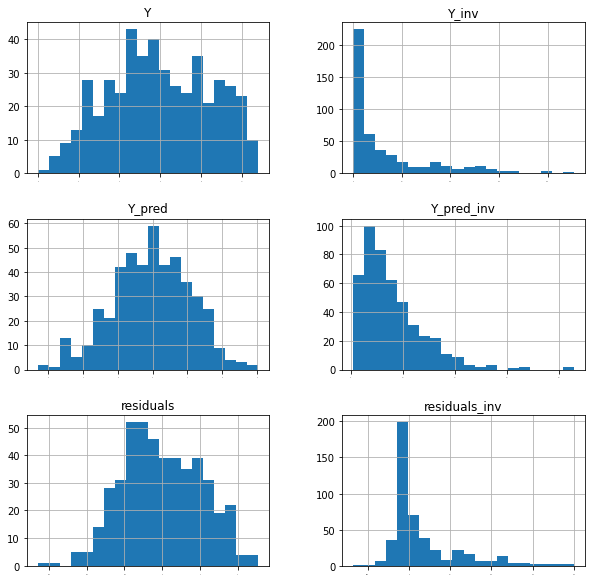

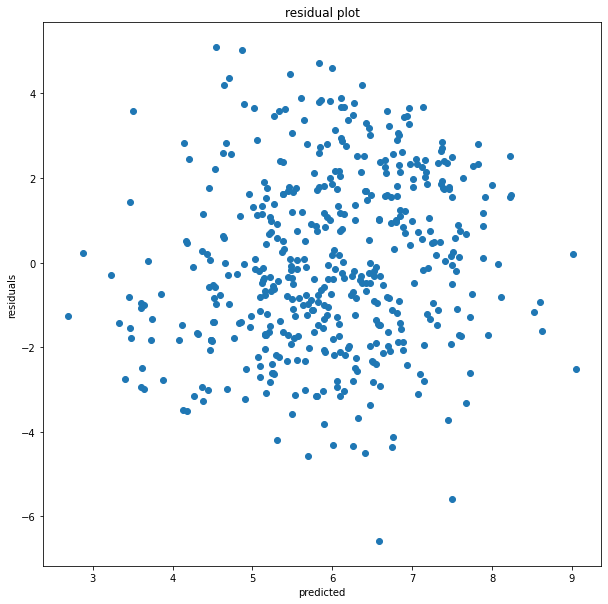

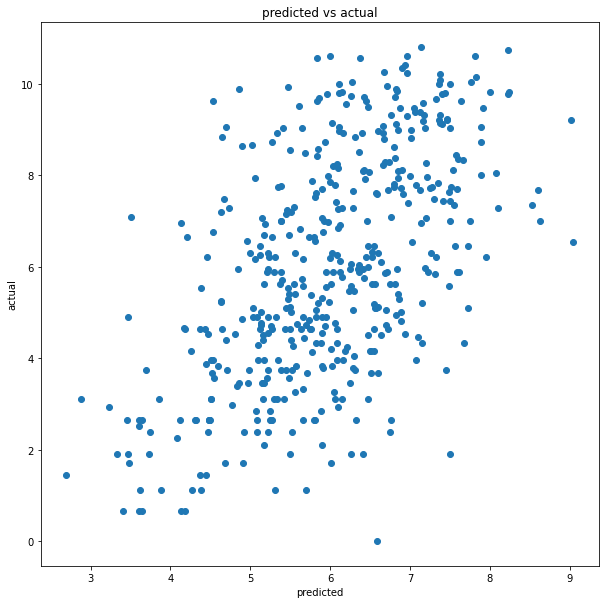

In [ ]:
# Train the model on the training data (note: 1 acre ~ 0.75 football field)
model_params = {
    "alpha": 0.1, # a=0 => no regularization, a=1 => complete regularization 
    "fit_intercept": True, # False => line through origin
    "tol": 0.001,
    "max_iter": 100000
}
# model = LinearRegression()
# model = Ridge(alpha=model_params["alpha"])
# model = Lasso(**model_params)
model = ElasticNet(**model_params, l1_ratio=0.5) # r=0 => ridge, r=1 => lasso
results_train = run_regression(X_train, y_train, model)
results_train.describe()

mae_inv:  312.9442948422895
mae:  2.23672290201001
rmse:  2.687108063800156


,Y,Y_inv,Y_pred,Y_pred_inv,residuals,residuals_inv
count,200.000000,200.000000,200.000000,200.000000,200.000000,200.000000
mean,5.870588,320.076200,5.979658,169.730405,-0.109071,150.345795
std,2.477534,455.729719,1.161118,158.511879,2.691631,488.862294
min,0.659158,1.000000,2.670459,10.271190,-6.520442,-922.059429
25%,4.028324,31.500000,5.214474,75.566848,-2.077092,-111.025660
50%,5.615674,100.000000,6.059845,135.315355,-0.191845,-7.142729
75%,7.780864,406.750000,6.612637,194.863034,2.096321,295.700538
max,10.727503,2171.000000,9.307429,997.059429,5.942374,2044.975886


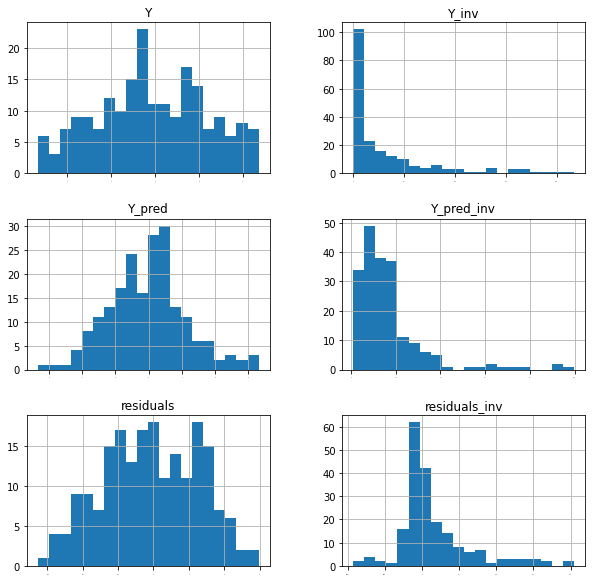

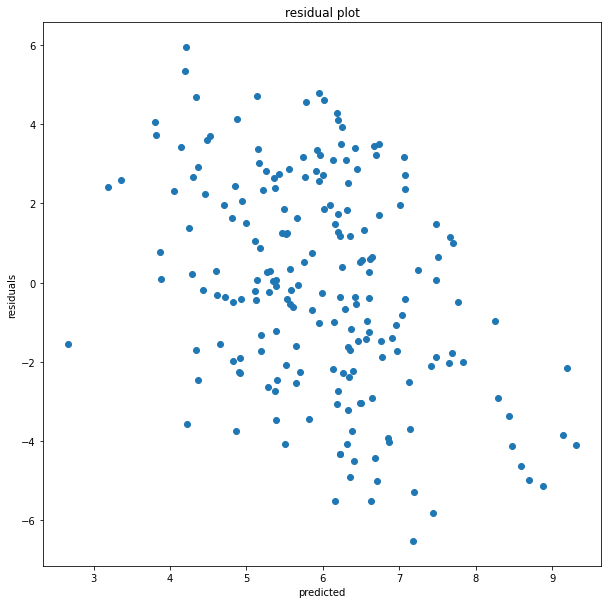

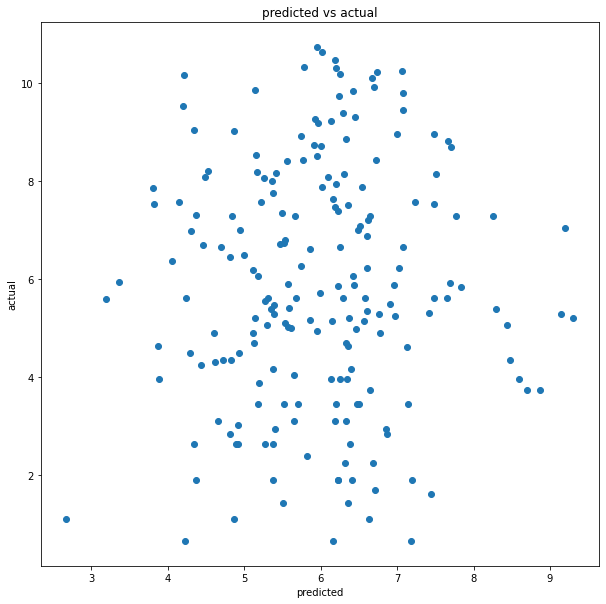

In [ ]:
# Find the cross validation error using the trained model
y_valid_pred = model.predict(X_valid)
results_valid = view_results(X_valid, y_valid, y_valid_pred)
results_valid.describe()

In [ ]:
# # Find the test error using the trained model
# y_test_pred = model.predict(X_test)
# results_test = view_results(X_test, y_test, y_test_pred)
# results_test.describe()

In [ ]:
len(X_train)

324

# Learning Curves

In [ ]:
# def inv_box_cox_transform_2(series, min_val, lmbda):
#     """Applies an inverse Box-Cox transformation to a series with a given lambda value"""
#     inv = inv_boxcox(series, lmbda)
#     s = np.array([x-1.0+min_val for x in inv]).reshape(-1, 1)
#     return s

def plot_learning_curves(model, X_train, X_val, y_train, y_val):
#     X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2)
    fig1 = plt.figure(figsize=(10,5))
#     fig2 = plt.figure(figsize=(10,5))
    ax1 = fig1.add_subplot(111)
    ax1.set_xlabel("Training set size")
    ax1.set_ylabel("RMSE")
    ax1.set_title("Loss")
    
#     ax2 = fig2.add_subplot(111)
#     ax2.set_xlabel("Training set size")
#     ax2.set_ylabel("MAE")
#     ax2.set_title("Loss")
    
    train_errors, val_errors = [], []
#     train_errors_inv_mae, val_errors_inv_mae = [], []
#     train_errors_inv_mse, val_errors_inv_mse = [], []
    training_instances = len(X_train)
    for m in range(1, training_instances):
        model.fit(X_train[:m], y_train[:m])
    
#         y_train_inv = inv_box_cox_transform_2(y_train, **params["Size"])
#         y_val_inv = inv_box_cox_transform_2(y_val, **params["Size"])
    
        y_train_predict = model.predict(X_train[:m])
        y_val_predict = model.predict(X_val)
        
#         y_train_predict_inv = inv_box_cox_transform_2(y_train_predict, **params["Size"])
#         y_val_predict_inv = inv_box_cox_transform_2(y_val_predict, **params["Size"])
        
        train_errors.append(mean_squared_error(y_train[:m], y_train_predict))
        val_errors.append(mean_squared_error(y_val, y_val_predict))
        
#         train_errors_inv_mae.append(mean_absolute_error(y_train_inv[:m], y_train_predict_inv))
#         val_errors_inv_mae.append(mean_absolute_error(y_val_inv, y_val_predict_inv))
        
#         train_errors_inv_mse.append(mean_squared_error(y_train_inv[:m], y_train_predict_inv))
#         val_errors_inv_mse.append(mean_squared_error(y_val_inv, y_val_predict_inv))
        
    print("final train rmse: ", train_errors[-1])
    print("final val rmse: ",   val_errors[-1])
    print("final rmse diff: ", val_errors[-1]-train_errors[-1])
    print("\n")
#     print("final train_inv mae: ",  train_errors_inv_mae[-1])
#     print("final val_inv mae: ",    val_errors_inv_mae[-1])
#     print("final train_inv rmse: ",  np.sqrt(train_errors_inv_mse)[-1])
#     print("final val_inv rmse: ",    np.sqrt(val_errors_inv_mse)[-1])
    ax1.plot(np.sqrt(train_errors), "r-+", linewidth=2, label="Training set")
    ax1.plot(np.sqrt(val_errors), "b-", linewidth=3, label="Validation set")
#     ax2.plot(train_errors_inv_mae, "m-+", linewidth=2, label="Training set inv")
#     ax2.plot(val_errors_inv_mae, "c-", linewidth=3, label="Validation set inv")
    ax1.legend(loc="upper right")
#     ax2.legend(loc="upper right")

In [ ]:
# The hyperparameter α controls how much you want to regularize the model. 
# If α = 0 then Ridge/Lasso/ElasticNet Regression is just Linear Regression.
# If α is very large, then all weights end up very close to zero and the result 
# is a flat line going through the data’s mean.

lr = LinearRegression()
ridge = Ridge(**model_params)
lasso = Lasso(**model_params)
elastic_net = ElasticNet(**model_params, l1_ratio=0.5)

In [ ]:
[col for col in ndf.columns.to_list() if col != "Size"]
X_valid = X_valid_df[features]
y_valid = y_valid_df.values.reshape(-1, 1)

Linear regression
final train rmse:  3.0388487680350002e-05
final val rmse:  1.858248756040025e+17
final rmse diff:  1.858248756040025e+17


Ridge regression
final train rmse:  0.005512418636994758
final val rmse:  16.521910810057314
final rmse diff:  16.51639839142032


Lasso regression


/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0, tolerance: 0.0
  positive)


final train rmse:  4.743831918752565
final val rmse:  6.4706946676885755
final rmse diff:  1.7268627489360107


ElasticNet regression


/usr/local/lib/python3.6/dist-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 0.0, tolerance: 0.0
  positive)


final train rmse:  4.3006643896633525
final val rmse:  6.826276389308907
final rmse diff:  2.5256119996455544




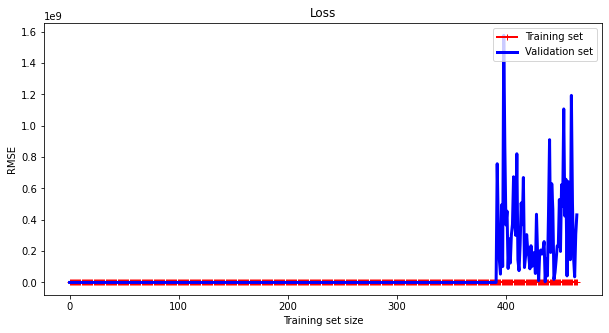

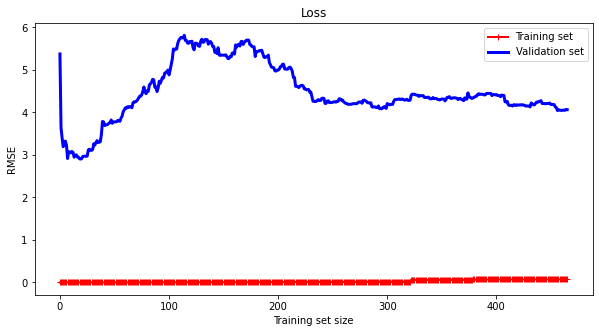

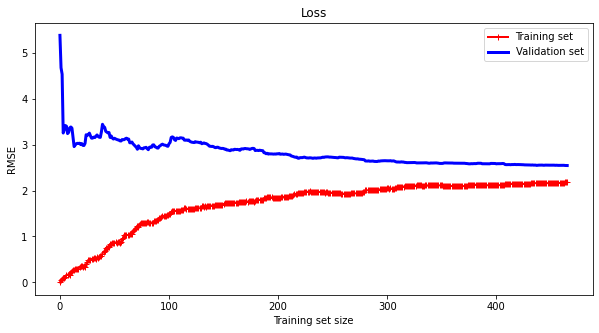

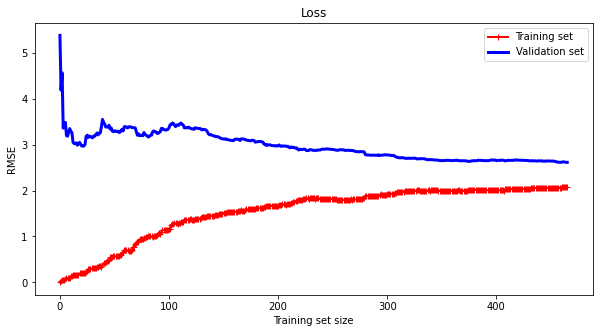

In [ ]:
print("Linear regression")
plot_learning_curves(lr, X_train, X_valid, y_train, y_valid)
print("Ridge regression")
plot_learning_curves(ridge, X_train, X_valid, y_train, y_valid)
print("Lasso regression")
plot_learning_curves(lasso, X_train, X_valid, y_train, y_valid)
print("ElasticNet regression")
plot_learning_curves(elastic_net, X_train, X_valid, y_train, y_valid)

mae_inv:  278.65541678223195
mae:  1.9442137986027914
rmse:  2.3704594660732505
     Y_inv  Y_pred_inv  residuals_inv
0    214.0   98.553783     115.446217
1      2.0   76.014636     -74.014636
2     64.0   46.959669      17.040331
3    175.0  105.560518      69.439482
4     15.0  114.414565     -99.414565
5     15.0  101.373547     -86.373547
6    634.0   71.317385     562.682615
7    427.0  127.056914     299.943086
8     86.0  370.483068    -284.483068
9    100.0  179.236855     -79.236855
10   525.0   90.090823     434.909177
11   225.0   81.276252     143.723748
12    25.0  163.612693    -138.612693
13    12.0   86.296779     -74.296779
14  2044.0  202.532114    1841.467886
15  1127.0   70.285423    1056.714577
16   107.0  130.092102     -23.092102
17    30.0   71.675478     -41.675478
18    32.0  296.884205    -264.884205
19   115.0  233.054269    -118.054269
20   200.0  106.303240      93.696760
21   391.0  122.419158     268.580842
22   300.0   77.358400     222.641600
23   258

,Y,Y_inv,Y_pred,Y_pred_inv,residuals,residuals_inv
count,288.000000,288.000000,288.000000,288.000000,288.000000,288.000000
mean,5.927672,319.536458,6.033619,148.910032,-0.105948,170.626427
std,2.392529,463.613011,0.759869,74.820280,2.372213,463.486865
min,0.659158,1.000000,3.884268,28.156014,-6.589152,-503.923013
25%,4.265447,37.750000,5.506939,92.753515,-1.793570,-87.450590
50%,5.882303,120.000000,6.049321,134.316898,-0.206668,-13.834991
75%,7.682028,382.750000,6.608877,194.392662,1.492216,223.886656
max,10.810861,2269.000000,8.263544,543.923013,5.117828,2117.530160


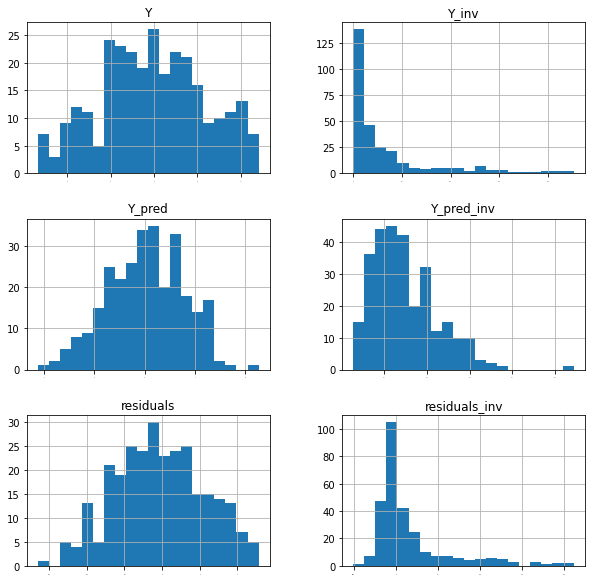

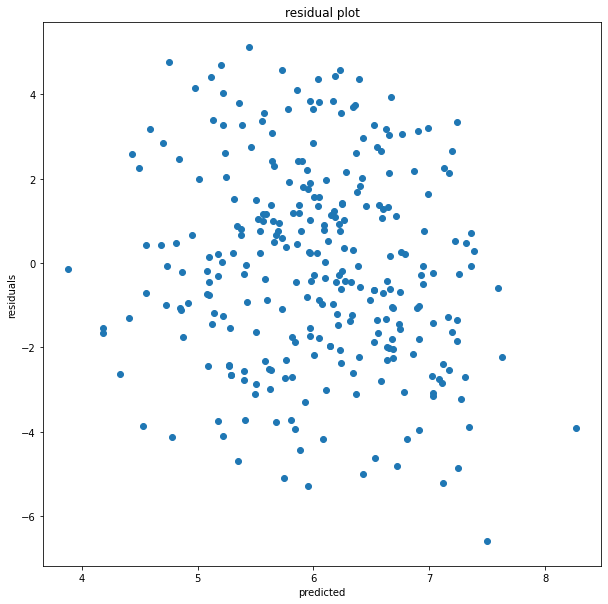

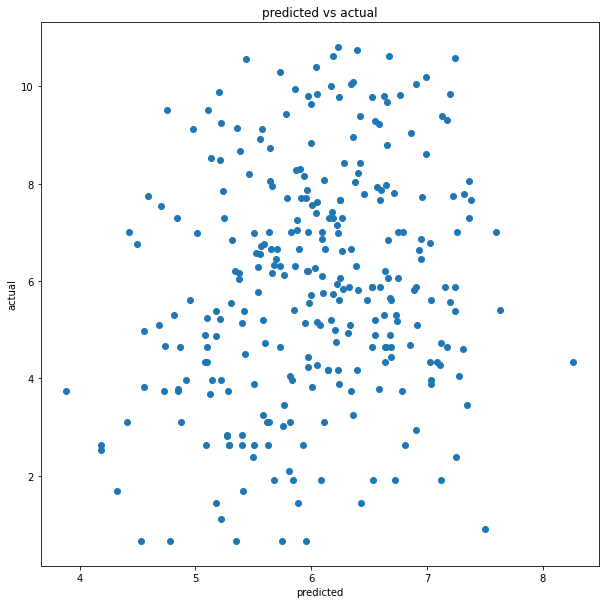

In [ ]:
# Find the test error using one of the trained models
model = lasso
y_test_pred = model.predict(X_test)
results_test = view_results(X_test, y_test, y_test_pred)
print(results_test.drop(columns=["Y", "Y_pred", "residuals"]).head(50).to_string())
results_test.describe()

# 3D Plot

<IPython.core.display.Javascript object>


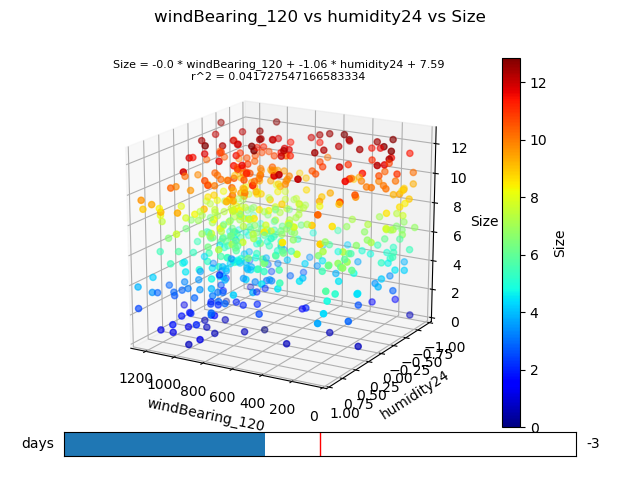

In [ ]:
# Visualize a 3D scatter plot for multiple features over time
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# descriptive features
f1 = abs_corr_specific_list[1]
f2 = abs_corr_specific_list[0]
f3 = "Size"
# target feature
f4 = "Size"

# select the dataframe to visualize
plot_df = ndf

# get feature bounds
f1_min, f1_max = get_feature_bounds(plot_df, f1)
f2_min, f2_max = get_feature_bounds(plot_df, f2)
f3_min, f3_max = get_feature_bounds(plot_df, f3)

def draw_scatter(i, ax, df):
    factor = 24
    index = i*factor
    f = lambda i, x: "" if x in ["Costs", "Latitude", "Longitude"] else (str(i) if i >= 0 else "_"+str(abs(i)))

    # set the hour offset per feature
#     x1=f1+f(index, f1)
#     x2=f2+f(index, f2)
#     x3=f3+f(index, f3)
#     x4=f4

    x1=f1
    x2=f2
    x3=f3
    x4=f4

    # set the axis values per feature
    x = df[x1]
    y = df[x2]
    z = df[x3]
    c = df[x4]

    ax.set_xlabel(x1)
    ax.set_ylabel(x2)
    ax.set_zlabel(x3)

    # set constant axis bounds
    ax.set_xlim(f1_min, f1_max)
    ax.set_ylim(f2_min, f2_max)
    ax.set_zlim(f3_min, f3_max)

    linear_features = [x1,x2]
    linear_target = x3
    
    # create the linear regression model
    X = df[linear_features] # use first two features as predictors to third
    Y = df[linear_target].values.reshape(-1, 1)
    lr = LinearRegression()
    lr.fit(X, Y)
    Y_pred = lr.predict(X)

    # extract the model parameters, note rounded values!
    coefficients = lr.coef_.round(decimals=2)
    intercept = lr.intercept_.round(decimals=2)

    # construct the equation from model parameters
    equation = linear_target+" = "
    for i in range(len(coefficients[0])):
        coeff = coefficients[0][i]
        f = linear_features[i]
        equation+=str(coeff)+" * "+f+" + "
    else:
        equation+=str(intercept[0])

    # ax.plot(x, y, Y_pred.flatten())

    # construct the line of best fit (needs fix)
#     lx = np.arange(f1_min, f1_max, 0.715)
#     ly = np.arange(f2_min, f2_max, 0.25)
#     inter = np.full((1, len(lx)), intercept[0])
#     lz = lx*coefficients[0][0] + ly*coefficients[0][1] + inter[0]
    
#     ax.plot(lx, ly, lz)
    
    r_sq = lr.score(X, Y)
    r_sq_str = "r^2 = "+str(r_sq)
                                     
    img = ax.scatter(x, y, z, c=c, cmap="jet")
    
    ax.set_title(label=equation+"\n"+r_sq_str, fontsize=8)
    fig.suptitle(x1+" vs "+x2+" vs "+x3)
    return img



init_slider_val = 0

# Update the axis for the initial scatterplot
img = draw_scatter(init_slider_val, ax, plot_df)

# Draw the colorbar and label it with the target feature
fig.colorbar(img).set_label(f4)

# Create a new slider axes with specified dimensions
slider_ax = plt.axes([0.1, 0.05, 0.8, 0.05])

# Create the slider
a_slider = Slider(slider_ax,      # the axes object containing the slider
                  'days',         # the name of the slider parameter
                  -14,            # minimal value of the parameter
                  14,             # maximal value of the parameter
                  valinit=0.,     # initial value of the parameter
                  valfmt="%i"
                 )

# Create integer slider offsets
def set_slider(s,val):
    s.val = int(round(val))
    s.poly.xy[2] = s.val,1
    s.poly.xy[3] = s.val,0
    s.valtext.set_text(s.valfmt % s.val)

# function to be executed each time slider
# value changes, variable of this function will
# be assigned the value of the slider
def update(a):
    # update the slider
    set_slider(a_slider, a)
    # get the the updated slider value
    a = int(a_slider.val)
    # clear the axis
    ax.clear()
    # update the axis
    draw_scatter(a, ax, plot_df)
    # redraw the plot
    fig.canvas.draw_idle()

# execute update on slider change
a_slider.on_changed(update)

plt.show()

In [ ]:
# TODO: Use high dimensional regression equation on train/valid/test split (via cdf) and check RMSE values
# - Then try polynomial terms in high dimensional linear regression to maximize r^2

# - Then try to fit nonlinear functions like x^2 with mlp
# - Then see if you can generalize

In [ ]:
# Load data splits from previous run

# norm_X_train = pd.read_csv('.\\data\\'+'run_2'+'\\norm_X_train.csv', index_col=0).astype("float32")
# norm_y_train = pd.read_csv('.\\data\\'+'run_2'+'\\norm_y_train.csv', index_col=0).astype("float32")


# norm_X_valid = pd.read_csv('.\\data\\'+'run_2'+'\\norm_X_valid.csv', index_col=0).astype("float32")
# norm_y_valid = pd.read_csv('.\\data\\'+'run_2'+'\\norm_y_valid.csv', index_col=0).astype("float32")

# norm_X_test = pd.read_csv('.\\data\\'+'run_2'+'\\norm_X_test.csv', index_col=0).astype("float32")
# norm_y_test = pd.read_csv('.\\data\\'+'run_2'+'\\norm_y_test.csv', index_col=0).astype("float32")

# print(norm_X_train.describe())
# print(norm_X_valid.describe())
# print(norm_X_test.describe())



In [ ]:
# # normalize the descriptive and target features across each data split
# norm_X_train = normalize(X_train)
# norm_X_valid = normalize(X_valid)
# norm_X_test = normalize(X_test)
# norm_y_train = normalize(y_train)
# norm_y_valid = normalize(y_valid)
# norm_y_test = normalize(y_test)

# # export normalized data splits to csv
# norm_X_train.to_csv('.\\data\\'+RUN_NAME+'\\norm_X_train.csv')
# norm_y_train.to_csv('.\\data\\'+RUN_NAME+'\\norm_y_train.csv')
# norm_X_valid.to_csv('.\\data\\'+RUN_NAME+'\\norm_X_valid.csv')
# norm_y_valid.to_csv('.\\data\\'+RUN_NAME+'\\norm_y_valid.csv')
# norm_X_test.to_csv('.\\data\\'+RUN_NAME+'\\norm_X_test.csv')
# norm_y_test.to_csv('.\\data\\'+RUN_NAME+'\\norm_y_test.csv')

# # plot distribution of normalized target feature for each data split
# norm_y_train_hist = norm_y_train.hist(bins=20, figsize=(18, 12), xlabelsize=10)
# plt.savefig('.\\data\\'+RUN_NAME+'\\norm_y_train_hist.png')
# norm_y_valid_hist = norm_y_valid.hist(bins=20, figsize=(18, 12), xlabelsize=10)
# plt.savefig('.\\data\\'+RUN_NAME+'\\norm_y_valid_hist.png')
# norm_y_test_hist = norm_y_test.hist(bins=20, figsize=(18, 12), xlabelsize=10)
# plt.savefig('.\\data\\'+RUN_NAME+'\\norm_y_test_hist.png')

# # summarize distribution of normalized descriptive features for each data split
# print("Training descriptive features summary:")
# print(norm_X_train.describe())
# print("Validation descriptive features summary:")
# print(norm_X_valid.describe())
# print("Test descriptive features summary:")
# print(norm_X_test.describe())

# # summarize distribution of normalized target feature for each data split
# print("Training targets summary:")
# print(y_train.describe())
# print("Validation targets summary:")
# print(y_valid.describe())
# print("Test targets summary:")
# print(y_test.describe())
# print("All fire targets summary:")
# print(y_all.describe())


# Neural Network Models

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Dense, Softmax


# # feed forward network with a single hidden layer
# # linear activation for dense layer by default unless specified
# # no need to specify input size/shape until training stage
# model = Sequential([
#                     Dense(64, activation='relu'), # 64 units
#                     Dense(10, activation='softmax')
# ])
# # alternatively, can explicitly tell model shape of input at build stage
# # e.g. one dimensional vector of size 784
# # thus, weights and biases are created when model instance defined
# model = Sequential([
#                     Dense(64, activation='relu', input_shape=(784,)), # 64 units
#                     Dense(10, activation='softmax')
# ])

# # alternatively, can use model.add method to add additional layers to the model
# model.add(Dense(64, activation='relu', input_shape=(784,)))
# model.add(Dense(10, activation='softmax'))

# # make first layer flatten layer
# model = Sequential([
#                     Flatten(input_shape=(28,28)), # 28 x 28 input => (784,)
#                     Dense(64, activation='relu'),
#                     Dense(10, activation='softmax')
# ])



# Multilayer Perceptron (Feed-forward Network)

In [ ]:
# model = Sequential([
#                     Flatten(input_shape=(28,28)),
#                     Dense(16, activation='relu'),
#                     Dense(16, activation='relu'),
#                     Dense(10, activation='softmax')
# ])
model = Sequential([
                    Flatten(input_shape=(28,28)),
                    Dense(16, activation='relu', name='layer_1'), # name layer
                    Dense(16, activation='relu'),
                    Dense(10), # linear activation
                    Softmax()
])

In [ ]:
model.summary()

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
flatten_3 (Flatten)          (None, 784)               0         
_________________________________________________________________
layer_1 (Dense)              (None, 16)                12560     
_________________________________________________________________
dense_8 (Dense)              (None, 16)                272       
_________________________________________________________________
dense_9 (Dense)              (None, 10)                170       
_________________________________________________________________
softmax_2 (Softmax)          (None, 10)                0         
Total params: 13,002
Trainable params: 13,002
Non-trainable params: 0
_________________________________________________________________


# Convolutional Neural Network

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Flatten, Dense, Conv2D, MaxPooling2D

model = Sequential([
                    # 16 filters, 3 pixel x 3 pixel convolutional kernel shape,
                    # 32 pixel x 32 pixel image with 3 color channels            # Tensor shapes at each layer
                    Conv2D(16, (3,3), activation='relu', input_shape=(32,32,3)), #  (None, 30, 30, 16)
                    MaxPooling2D((3,3)), # pooling window size 3 pixel x 3 pixel #  (None, 10, 10, 16)
                    Flatten(), # convert to a long one-dimensional vector        #  (None, 1600)
                    Dense(64, activation='relu'),                                #  (None, 64)
                    Dense(10, activation='softmax')                              #  (None, 10)
])
# first dimension of each tensor is the batch size which is flexible
# i.e. we can pass any number of examples in a batch to the model


In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D

model = Sequential([
                    Conv2D(16, (3,3), activation='relu', input_shape=(28,28,1), data_format='channels_last'),
                    MaxPooling2D((3,3)),
                    Flatten(),
                    Dense(10, activation='softmax')
])

# set the padding in the cnn as "same" so as to preserve the output dimensions
# the stride is 2 in every dimension
# larger strides reduce the output dimensions of the layers
# model = Sequential([
#                     Conv2D(16, (3,3), padding='SAME', strides=2, activation='relu', input_shape=(28,28,1)),
#                     MaxPooling2D((3,3)),
#                     Flatten(),
#                     Dense(10, activation='softmax')
# ])

In [ ]:
model.summary()

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_7 (Conv2D)            (None, 26, 26, 16)        160       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 8, 8, 16)          0         
_________________________________________________________________
flatten_7 (Flatten)          (None, 1024)              0         
_________________________________________________________________
dense_13 (Dense)             (None, 10)                10250     
Total params: 10,410
Trainable params: 10,410
Non-trainable params: 0
_________________________________________________________________


# Binary Classification Network

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# model = Sequential([
#                     # exponential linear unit activation function
#                     Dense(64, activation='elu', input_shape=(32,)),
#                     Dense(1, activation='sigmoid')
# ])

# more numerically stable approach
model = Sequential([
                    # exponential linear unit activation function
                    Dense(64, activation='elu', input_shape=(32,)),
                    Dense(1, activation='linear')
])

# defines the loss function and optimizer
# can optionally define set of metrics to keep track of as the model is training
# metrics will be calculated for each epoch of training along with the evaluation
# of the loss function on the training data
model.compile(
    optimizer='sgd', # 'adam', 'rmsprop', 'adadelta'
    loss='binary_crossentropy', # 'mean_squared_error', 'categorical_crossentropy'
    metrics=['mae'] # 'mape'
)

# alternatively can pass in api objects
model.compile( # by default: learning rate = 0.01, momentum = 0
    optimizer=tf.keras.optimizers.SGD(learning_rate=0.001, momentum=0.9, nesterov=True),
    # from_logits tells model to take output of the network and the loss function
    # itself should handle the squeezing of the output through the sigmoid activation
    loss=tf.keras.losses.BinaryCrossentropy(from_logits=True)
    # set threshold for predictions to be classed as positives (default=0.5)
    metrics=[tf.keras.metrics.BinaryAccuracy(threshold=0.7), tf.keras.metrics.MeanAbsoluteError()]
)


SyntaxError: ignored

In [ ]:
# Define the model optimizer, loss function, and metrics

opt = tf.keras.optimizers.Adam(learning_rate=0.005)
acc = tf.keras.metrics.SparseCategoricalAccuracy()
mae = tf.keras.metrics.MeanAbsoluteError()

model.compile(optimizer=opt, loss='sparse_categorical_crossentropy',
              metrics=[acc, mae])


In [ ]:
# Print the resulting model attributes
print(model.loss)
print(model.optimizer)
print(model.metrics)
print(model.optimizer.lr)

sparse_categorical_crossentropy
[]
<tf.Variable 'learning_rate:0' shape=() dtype=float32, numpy=0.005>


# Fit Method

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

model = Sequential([
                    Dense(64, activation='elu', input_shape=(32,)),
                    Dense(100, activation='softmax')
])

model.compile(
    optimizer='rmsprop',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

# train the model for one pass through the training data (one epoch) unless specified
# 10 complete passes through the dataset
# default batch_size=32
history = model.fit(X_train, y_train, epochs=10, batch_size=16)
# store result in TensorFlow history object
# contains progress of the network during training (metrics/loss)
# example of a "callback"

# numpy arrays
# X_train: (num_samples, num_features)
# y_train: (num_samples, num_classes)
